# Bird Species Classifier

Classifier model using vgg16 base model and training on dataset of 325 bird species from: https://www.kaggle.com/gpiosenka/100-bird-species/code

## Colab setup
Google Drive was used to store all the training data. Mount google drive in colab:

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Imports

In [3]:
import numpy as np
import pandas as pd
import glob

from os import path, listdir

from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from tensorflow.keras.preprocessing import image_dataset_from_directory
from tensorflow.keras.models import Sequential, save_model, load_model
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Conv2D, GlobalAveragePooling2D, Flatten, Dense
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from keras.applications.vgg16 import preprocess_input
from keras.applications.vgg16 import decode_predictions

import matplotlib.pyplot as plt

## Setup directory paths

In [5]:
# data directories
base_dir = 'data/'
# base_dir = r"/content/drive/MyDrive/data/"    # use this one in colab
train_dir = path.join(base_dir, "train")
val_dir = path.join(base_dir, "valid")
test_dir = path.join(base_dir, "test")

# Save directory for model saving and loading
save_path = 'saved_model/'

# Prediction images directory
prediction_path = 'prediction_images/'

## Load Datasets

In [41]:
# Dataset
batch_size=24
image_size=(256, 256)
train_ds = image_dataset_from_directory(train_dir, label_mode="categorical", batch_size=batch_size, image_size=image_size)
val_ds = image_dataset_from_directory(val_dir, label_mode="categorical", batch_size=batch_size, image_size=image_size)
test_ds = image_dataset_from_directory(test_dir, label_mode="categorical", batch_size=batch_size, image_size=image_size)

Found 47332 files belonging to 325 classes.
Found 1625 files belonging to 325 classes.
Found 1625 files belonging to 325 classes.


In [42]:
# Class names
classes = train_ds.class_names
print(classes)

['AFRICAN CROWNED CRANE', 'AFRICAN FIREFINCH', 'ALBATROSS', 'ALEXANDRINE PARAKEET', 'AMERICAN AVOCET', 'AMERICAN BITTERN', 'AMERICAN COOT', 'AMERICAN GOLDFINCH', 'AMERICAN KESTREL', 'AMERICAN PIPIT', 'AMERICAN REDSTART', 'ANHINGA', 'ANNAS HUMMINGBIRD', 'ANTBIRD', 'ARARIPE MANAKIN', 'ASIAN CRESTED IBIS', 'BALD EAGLE', 'BALD IBIS', 'BALI STARLING', 'BALTIMORE ORIOLE', 'BANANAQUIT', 'BANDED BROADBILL', 'BANDED PITA', 'BAR-TAILED GODWIT', 'BARN OWL', 'BARN SWALLOW', 'BARRED PUFFBIRD', 'BAY-BREASTED WARBLER', 'BEARDED BARBET', 'BEARDED BELLBIRD', 'BEARDED REEDLING', 'BELTED KINGFISHER', 'BIRD OF PARADISE', 'BLACK & YELLOW bROADBILL', 'BLACK BAZA', 'BLACK FRANCOLIN', 'BLACK SKIMMER', 'BLACK SWAN', 'BLACK TAIL CRAKE', 'BLACK THROATED BUSHTIT', 'BLACK THROATED WARBLER', 'BLACK VULTURE', 'BLACK-CAPPED CHICKADEE', 'BLACK-NECKED GREBE', 'BLACK-THROATED SPARROW', 'BLACKBURNIAM WARBLER', 'BLONDE CRESTED WOODPECKER', 'BLUE COAU', 'BLUE GROUSE', 'BLUE HERON', 'BLUE THROATED TOUCANET', 'BOBOLINK', 'BO

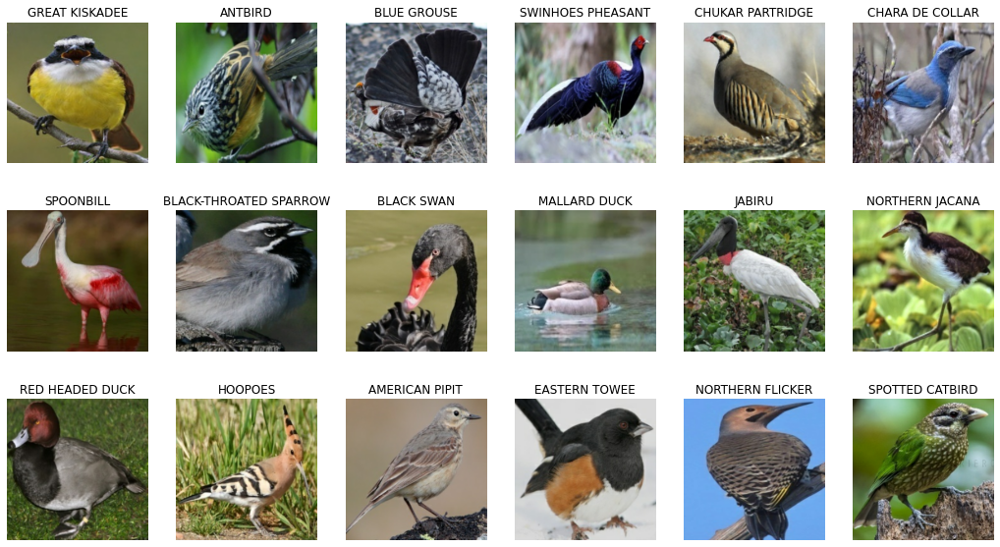

In [9]:
# visualizing images with labels
for images, labels in train_ds.take(1):
    labels = np.argmax(labels, axis=-1)
    plt.figure(figsize=(18, 10))
    for i in range(18):
        plt.subplot(3, 6, i+1)
        plt.imshow(images[i].numpy().astype('uint8'))
        plt.title(classes[labels[i]])
        plt.axis('off')

plt.show()

## Load Pretrained VGG16 Model

In [10]:
# Pretrained vgg16
conv_base = VGG16(include_top=False, weights='imagenet', input_shape=(256, 256, 3))

58900480/58889256 [==============================] - 0s 0us/step


In [11]:
# making conv_base non-trainable
conv_base.trainable = False

In [12]:
# Defining model
model = Sequential()
model.add(conv_base)
model.add(GlobalAveragePooling2D())
model.add(Flatten())
model.add(Dense(1048, activation='relu'))
model.add(Dense(325, activation='softmax'))
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 8, 8, 512)         14714688  
                                                                 
 global_average_pooling2d (G  (None, 512)              0         
 lobalAveragePooling2D)                                          
                                                                 
 flatten (Flatten)           (None, 512)               0         
                                                                 
 dense (Dense)               (None, 1048)              537624    
                                                                 
 dense_1 (Dense)             (None, 325)               340925    
                                                                 
Total params: 15,593,237
Trainable params: 878,549
Non-trainable params: 14,714,688
______________________________________

In [13]:
# defining callback and compiling the model
callbacks = [EarlyStopping(monitor="val_loss", patience=3, verbose=1),
            ReduceLROnPlateau(monitor = 'val_loss', factor=0.1, patience=2, verbose=1)]
model.compile(optimizer='rmsprop', loss='categorical_crossentropy', metrics=['acc'])

## Train Model

In [14]:
# training the model
history = model.fit(train_ds, epochs=40, validation_data=val_ds, verbose=1, callbacks=callbacks)

Epoch 1/40
1973/1973 [==============================] - 8146s 4s/step - loss: 2.0434 - acc: 0.5540 - val_loss: 0.9185 - val_acc: 0.7668 - lr: 0.0010
Epoch 2/40
1973/1973 [==============================] - 157s 79ms/step - loss: 1.0511 - acc: 0.7594 - val_loss: 0.9020 - val_acc: 0.8012 - lr: 0.0010
Epoch 3/40
1973/1973 [==============================] - 157s 79ms/step - loss: 0.8880 - acc: 0.8075 - val_loss: 1.1711 - val_acc: 0.7877 - lr: 0.0010
Epoch 4/40
1973/1973 [==============================] - 157s 79ms/step - loss: 0.8044 - acc: 0.8347 - val_loss: 0.8770 - val_acc: 0.8455 - lr: 0.0010
Epoch 5/40
1973/1973 [==============================] - 157s 79ms/step - loss: 0.7314 - acc: 0.8560 - val_loss: 0.9791 - val_acc: 0.8474 - lr: 0.0010
Epoch 6/40
1972/1973 [============================>.] - ETA: 0s - loss: 0.6697 - acc: 0.8734
Epoch 00006: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.
1973/1973 [==============================] - 156s 79ms/step - loss: 0.6696 - 

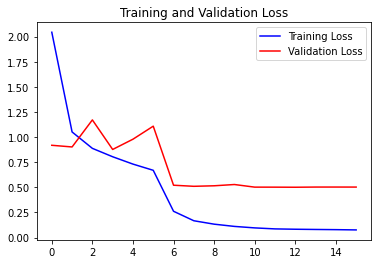

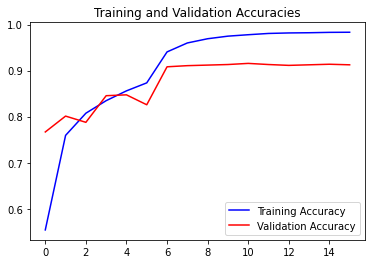

In [19]:
# visulizing results
loss = history.history["loss"]
val_loss = history.history["val_loss"]

epochs = range(len(loss))
plt.plot(epochs, loss, "b", label="Training Loss")
plt.plot(epochs, val_loss, "r", label="Validation Loss")
plt.title("Training and Validation Loss")
plt.legend()

plt.figure()
acc = history.history["acc"]
val_acc = history.history["val_acc"]
plt.plot(epochs, acc, "b", label="Training Accuracy")
plt.plot(epochs, val_acc, "r", label="Validation Accuracy")
plt.title("Training and Validation Accuracies")
plt.legend(loc="lower right")

## Test Model

In [11]:
# Final Results
model.evaluate(test_ds)

68/68 [==============================] - 242s 4s/step - loss: 0.3720 - acc: 0.9163


[0.3720357120037079, 0.9163076877593994]

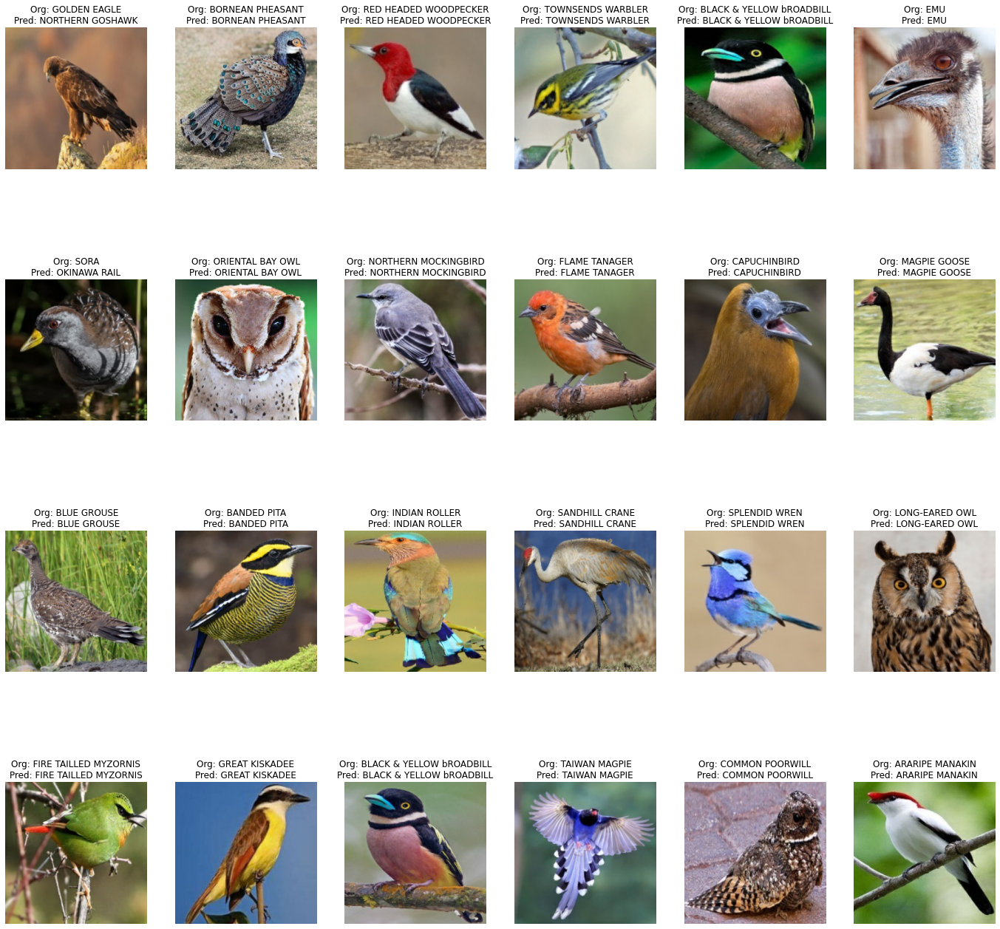

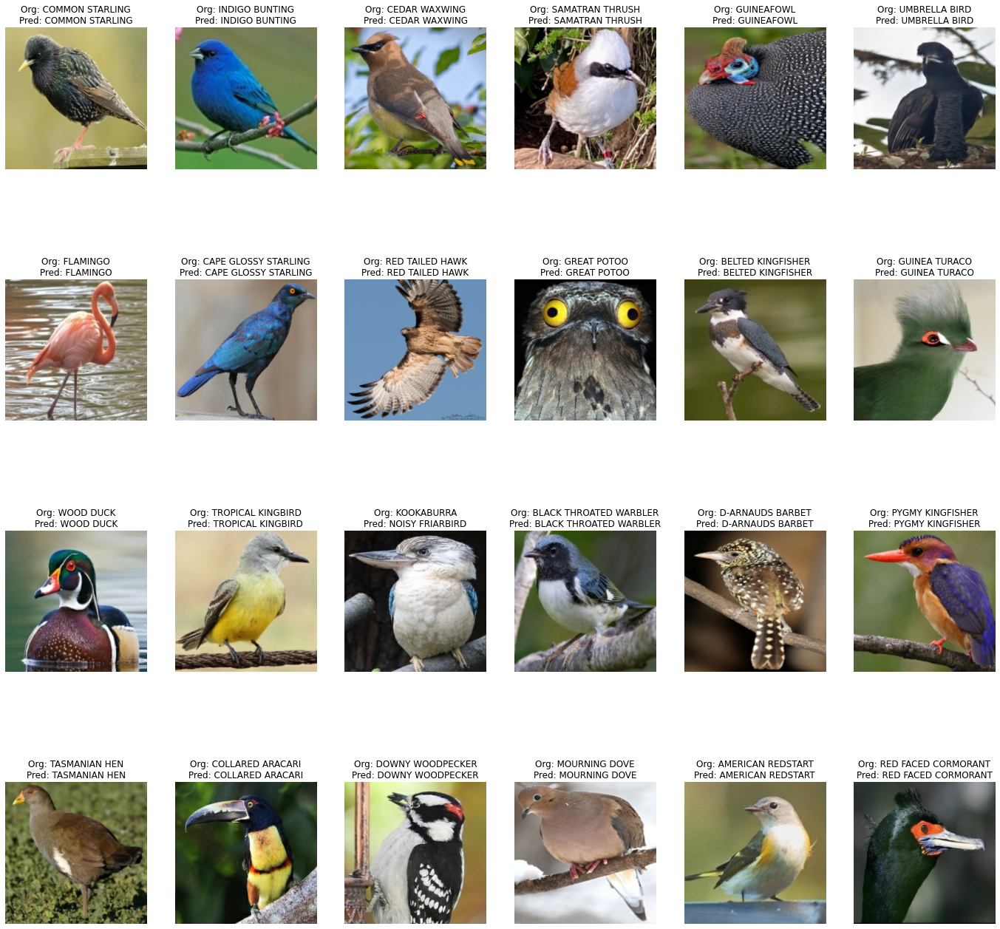

In [10]:

for images, labels in test_ds.take(2):
    pred = model.predict(images)
    labels = np.argmax(labels, axis=-1)
    pred = np.argmax(pred, axis=-1)
    plt.figure(figsize=(24, 24))
    for i in range(24):
        plt.subplot(4, 6, i+1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(f"Org: {classes[labels[i]]}\nPred: {classes[pred[i]]}")
        plt.axis("off")
    plt.show()

## Save Model

In [ ]:
save_model(model, save_path)

## Load saved model

In [9]:
model = load_model(save_path, compile = True)

## Make Predictions

In [43]:
def predict_on_image(image):
    image_array = img_to_array(image)

    # reshape data for the model
    image_array = image_array.reshape((1, image_array.shape[0], image_array.shape[1], image_array.shape[2]))

    # predict the probability across all output classes
    yhat = model.predict(image_array)
    pred_classes = np.argsort(yhat)[0][::-1]
    
    # show top 3 guesses
    for x in range(3):
        confidence = f'{yhat[0][pred_classes[x]]:.0%}'
        possible_class = classes[pred_classes[x]]
        print(possible_class, confidence)

    image.show()
    

### Predict on single image

EASTERN TOWEE 85%
EURASIAN MAGPIE 11%
SUPERB STARLING 2%


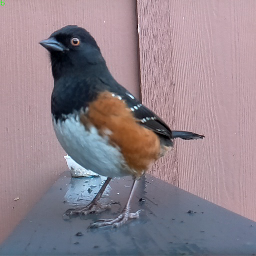

In [44]:
# load an image from file
image = load_img('test_image.jpg', target_size=(256, 256))
predict_on_image(image)

### Predict test folder

MALLARD DUCK 31%
MYNA 20%
VIOLET GREEN SWALLOW 19%


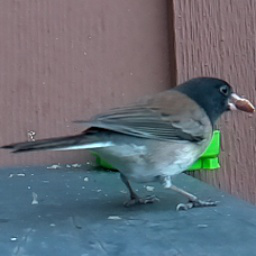

MANGROVE CUCKOO 37%
MYNA 9%
RED NAPED TROGON 7%


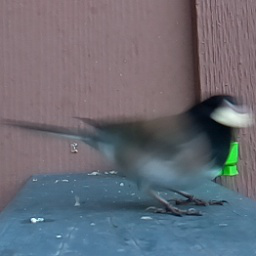

JAVA SPARROW 79%
EMPEROR PENGUIN 12%
MALLARD DUCK 2%


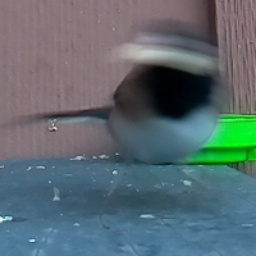

PUFFIN 100%
PARAKETT  AKULET 0%
OYSTER CATCHER 0%


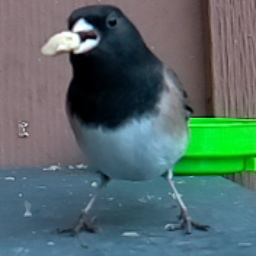

TROPICAL KINGBIRD 53%
CAPE MAY WARBLER 18%
SNOWY EGRET 11%


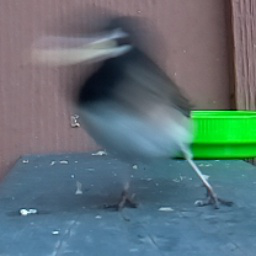

RED HEADED DUCK 46%
MALLARD DUCK 35%
PURPLE GALLINULE 17%


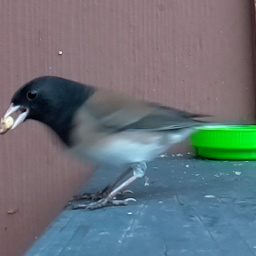

ROSY FACED LOVEBIRD 85%
GUINEA TURACO 13%
MANGROVE CUCKOO 1%


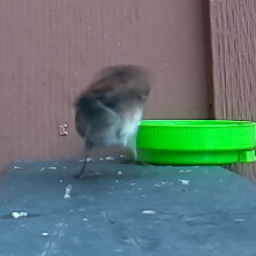

AMERICAN GOLDFINCH 56%
BLACK SKIMMER 21%
SPOON BILED SANDPIPER 5%


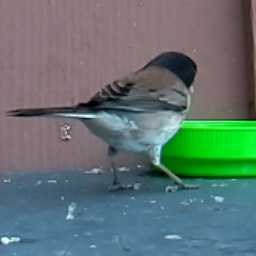

CASPIAN TERN 69%
MALLARD DUCK 17%
ROSY FACED LOVEBIRD 10%


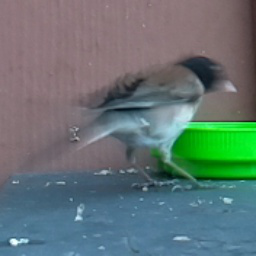

AMERICAN REDSTART 48%
TIT MOUSE 26%
AMERICAN GOLDFINCH 14%


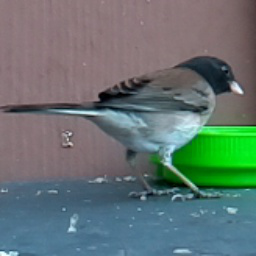

AMERICAN GOLDFINCH 30%
COMMON FIRECREST 30%
RED FACED WARBLER 10%


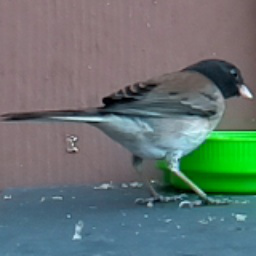

RED FACED WARBLER 21%
COUCHS KINGBIRD 14%
INDIAN PITTA 10%


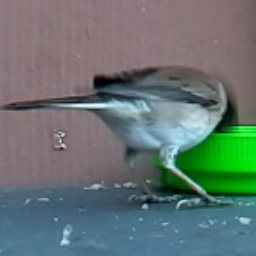

AMERICAN GOLDFINCH 59%
RED FACED WARBLER 13%
BAY-BREASTED WARBLER 6%


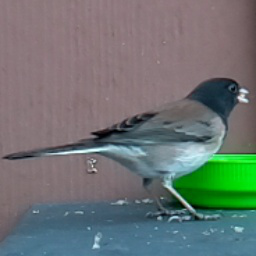

HOUSE SPARROW 59%
BAY-BREASTED WARBLER 9%
RED FACED WARBLER 9%


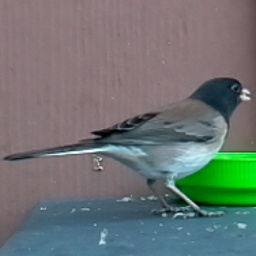

AMERICAN GOLDFINCH 22%
EASTERN TOWEE 21%
VIOLET GREEN SWALLOW 19%


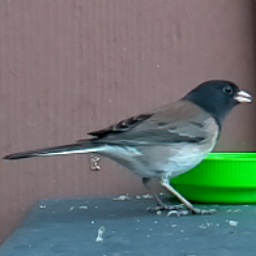

TREE SWALLOW 40%
CANARY 19%
AMERICAN GOLDFINCH 15%


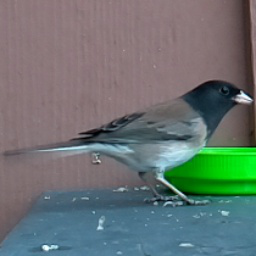

BLACK SKIMMER 27%
CASPIAN TERN 21%
RED NAPED TROGON 14%


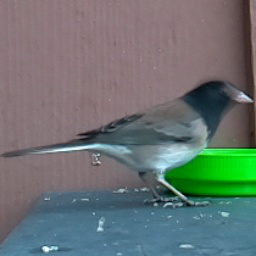

DARK EYED JUNCO 100%
BLACK-THROATED SPARROW 0%
NORTHERN CARDINAL 0%


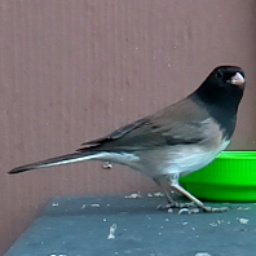

DARK EYED JUNCO 99%
NORTHERN CARDINAL 0%
BLACK THROATED WARBLER 0%


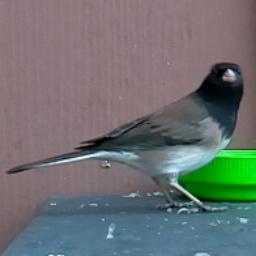

DARK EYED JUNCO 100%
MALAGASY WHITE EYE 0%
NORTHERN CARDINAL 0%


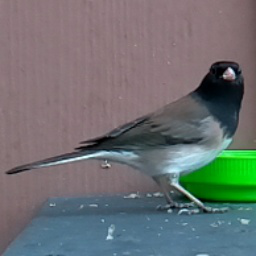

DARK EYED JUNCO 96%
MALAGASY WHITE EYE 2%
BAY-BREASTED WARBLER 1%


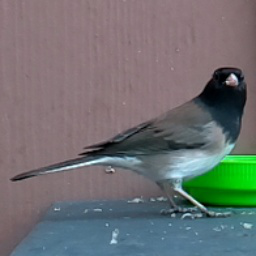

CANARY 60%
BALTIMORE ORIOLE 9%
CEDAR WAXWING 8%


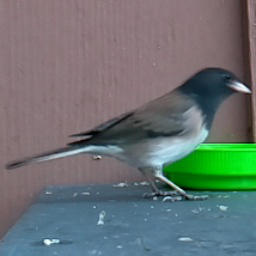

BALTIMORE ORIOLE 62%
TREE SWALLOW 10%
MALAGASY WHITE EYE 8%


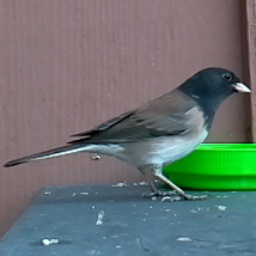

BALI STARLING 36%
CANARY 29%
COUCHS KINGBIRD 10%


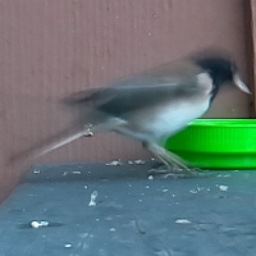

BALI STARLING 44%
JAVA SPARROW 29%
CEDAR WAXWING 9%


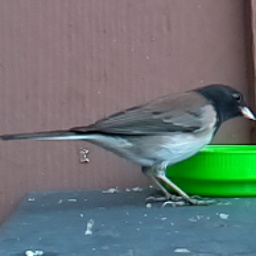

JAVA SPARROW 82%
MANGROVE CUCKOO 12%
WHITE TAILED TROPIC 1%


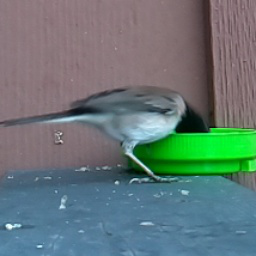

BALI STARLING 62%
MALAGASY WHITE EYE 29%
BEARDED REEDLING 4%


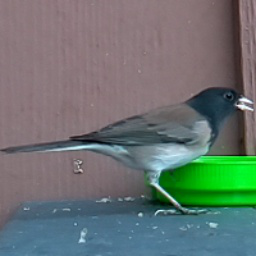

TIT MOUSE 69%
NORTHERN CARDINAL 9%
RED FACED WARBLER 8%


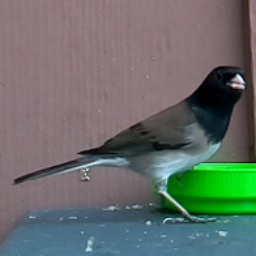

NORTHERN CARDINAL 37%
TIT MOUSE 20%
AFRICAN FIREFINCH 12%


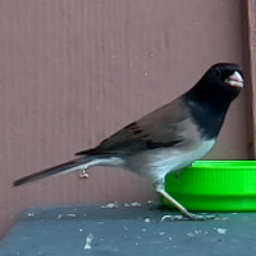

MALLARD DUCK 27%
OYSTER CATCHER 24%
LARK BUNTING 15%


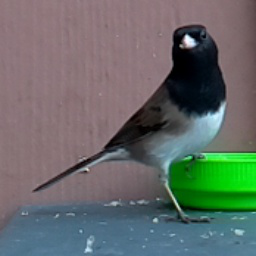

AMERICAN GOLDFINCH 58%
VIOLET GREEN SWALLOW 17%
MASKED LAPWING 6%


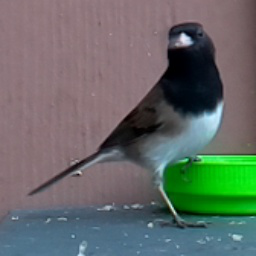

MALLARD DUCK 72%
OYSTER CATCHER 8%
ROCK DOVE 6%


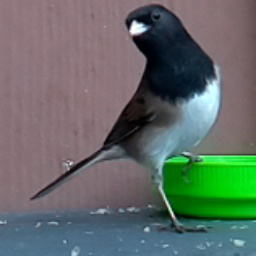

EURASIAN MAGPIE 45%
JAVA SPARROW 19%
BLACK THROATED WARBLER 17%


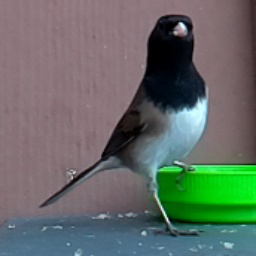

EURASIAN MAGPIE 52%
ARARIPE MANAKIN 17%
JAVA SPARROW 11%


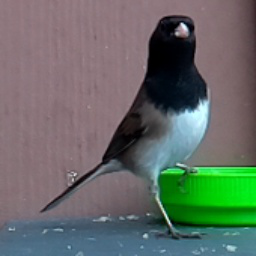

EURASIAN MAGPIE 81%
TREE SWALLOW 19%
BALI STARLING 0%


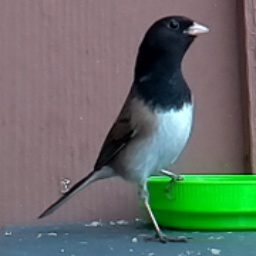

BALI STARLING 94%
AMERICAN GOLDFINCH 3%
TREE SWALLOW 1%


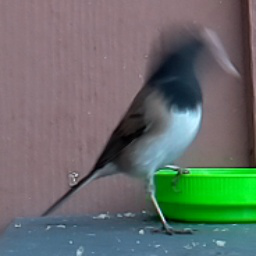

BALTIMORE ORIOLE 82%
AMERICAN GOLDFINCH 17%
TREE SWALLOW 1%


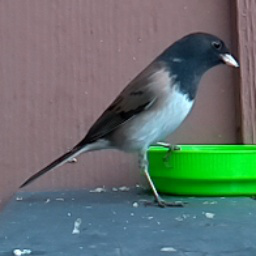

BALI STARLING 91%
JAVA SPARROW 3%
GUINEA TURACO 2%


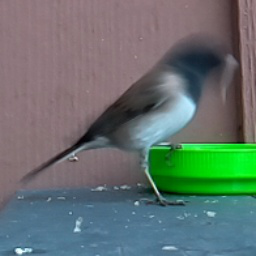

ARARIPE MANAKIN 81%
BALI STARLING 11%
JAVA SPARROW 3%


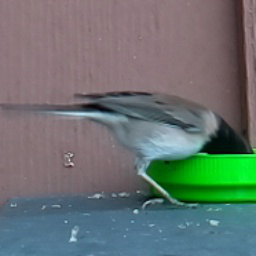

AMERICAN GOLDFINCH 69%
BALTIMORE ORIOLE 17%
AMERICAN REDSTART 5%


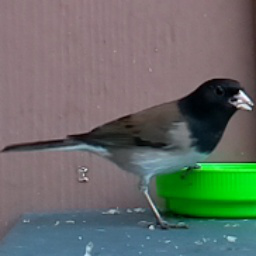

GREEN JAY 83%
JAVA SPARROW 10%
ROSY FACED LOVEBIRD 3%


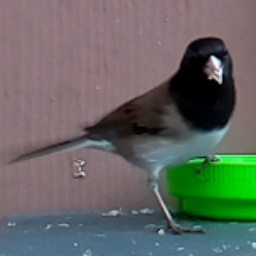

VIOLET GREEN SWALLOW 34%
AMERICAN GOLDFINCH 15%
EURASIAN MAGPIE 14%


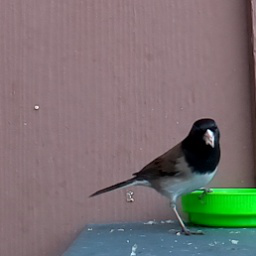

AMERICAN GOLDFINCH 67%
VIOLET GREEN SWALLOW 24%
PARUS MAJOR 6%


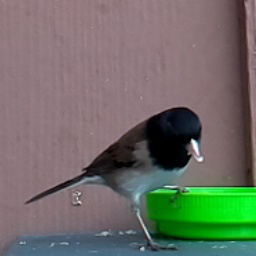

LARK BUNTING 82%
OYSTER CATCHER 9%
ROSY FACED LOVEBIRD 3%


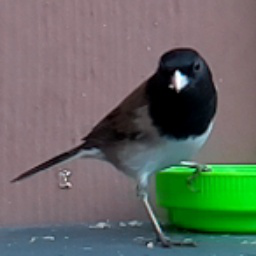

BLACK THROATED WARBLER 66%
MALLARD DUCK 28%
EASTERN TOWEE 3%


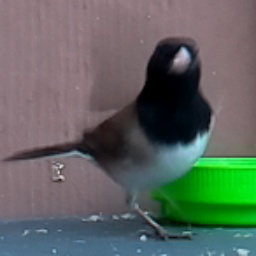

MALLARD DUCK 42%
BEARDED REEDLING 28%
ROSY FACED LOVEBIRD 14%


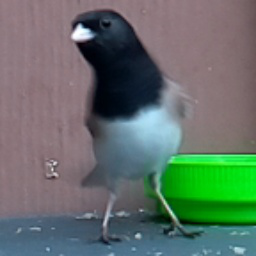

MALLARD DUCK 59%
ROCK DOVE 22%
EURASIAN MAGPIE 6%


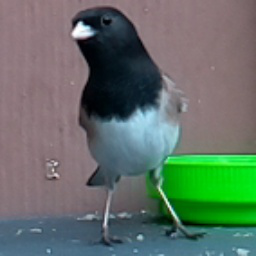

JAVA SPARROW 68%
PUFFIN 14%
MASKED LAPWING 5%


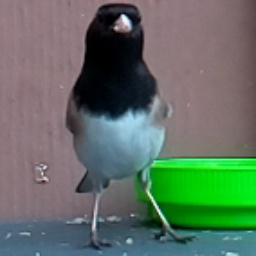

MASKED LAPWING 60%
MALEO 28%
EURASIAN MAGPIE 6%


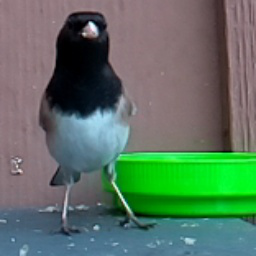

BLACK THROATED WARBLER 47%
EASTERN TOWEE 33%
BALTIMORE ORIOLE 10%


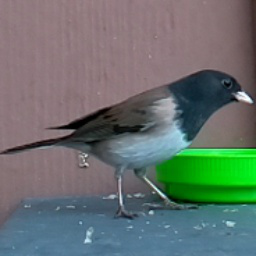

ARARIPE MANAKIN 89%
ROSY FACED LOVEBIRD 7%
TREE SWALLOW 1%


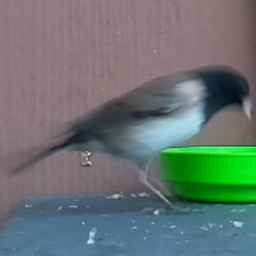

AMERICAN GOLDFINCH 83%
EVENING GROSBEAK 5%
JAVA SPARROW 4%


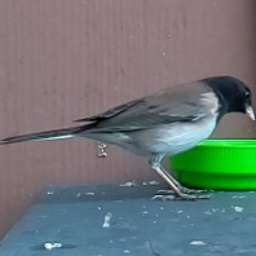

JAVA SPARROW 98%
ARARIPE MANAKIN 2%
BLACK SKIMMER 0%


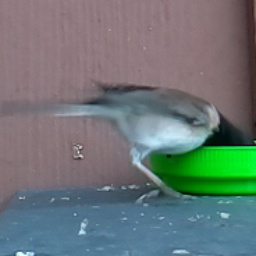

BALI STARLING 100%
ROSY FACED LOVEBIRD 0%
MANGROVE CUCKOO 0%


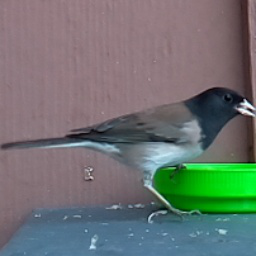

NORTHERN JACANA 49%
PURPLE GALLINULE 43%
ROSY FACED LOVEBIRD 2%


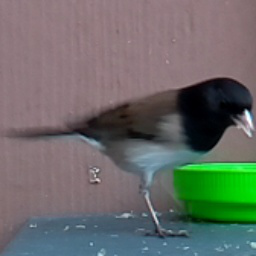

EASTERN TOWEE 76%
AMERICAN REDSTART 9%
BALTIMORE ORIOLE 7%


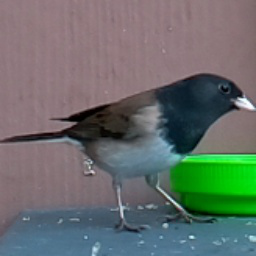

EVENING GROSBEAK 45%
AMERICAN GOLDFINCH 24%
JAVA SPARROW 21%


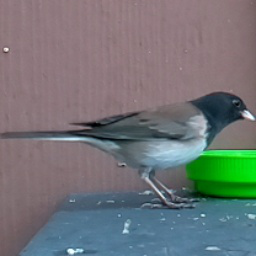

EVENING GROSBEAK 36%
BALTIMORE ORIOLE 25%
AMERICAN GOLDFINCH 12%


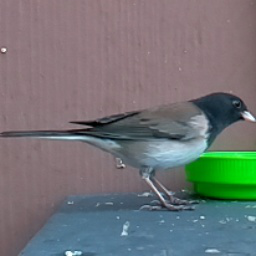

CALIFORNIA GULL 34%
WHITE BROWED CRAKE 12%
BALI STARLING 12%


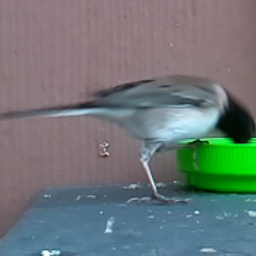

JAVA SPARROW 55%
BALI STARLING 44%
MANGROVE CUCKOO 1%


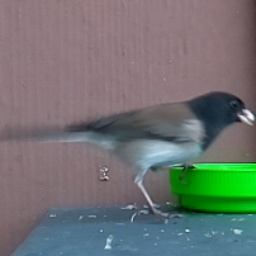

PURPLE GALLINULE 57%
NORTHERN JACANA 40%
GUINEA TURACO 1%


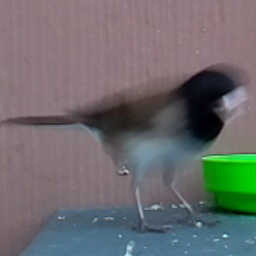

PINK ROBIN 58%
BALTIMORE ORIOLE 19%
EASTERN TOWEE 18%


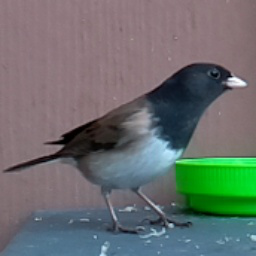

BALTIMORE ORIOLE 51%
EASTERN TOWEE 26%
DARK EYED JUNCO 11%


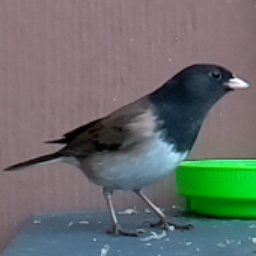

EASTERN TOWEE 44%
BALTIMORE ORIOLE 34%
DARK EYED JUNCO 12%


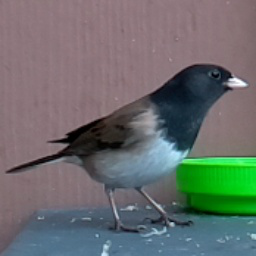

BALTIMORE ORIOLE 86%
DARK EYED JUNCO 8%
EASTERN TOWEE 4%


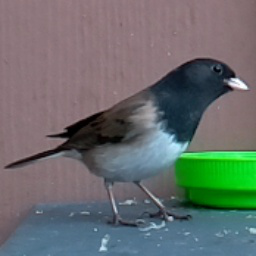

BALTIMORE ORIOLE 98%
NORTHERN JACANA 1%
EASTERN TOWEE 1%


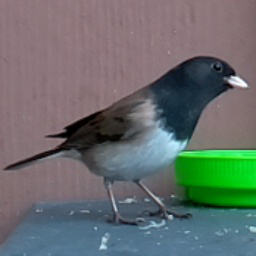

PURPLE GALLINULE 69%
MALAGASY WHITE EYE 17%
BALTIMORE ORIOLE 6%


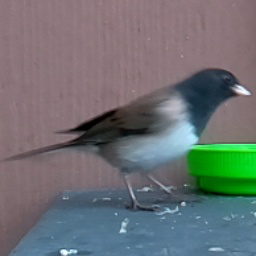

PURPLE GALLINULE 78%
BALTIMORE ORIOLE 22%
MALAGASY WHITE EYE 0%


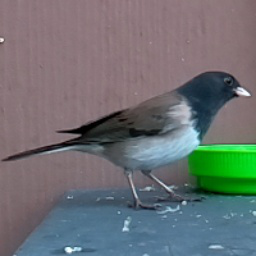

BALTIMORE ORIOLE 61%
PURPLE GALLINULE 37%
MALAGASY WHITE EYE 2%


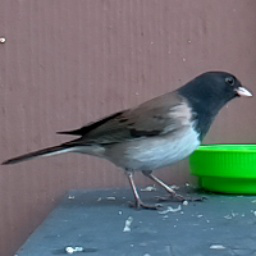

BLACK-THROATED SPARROW 47%
TIT MOUSE 44%
NORTHERN MOCKINGBIRD 2%


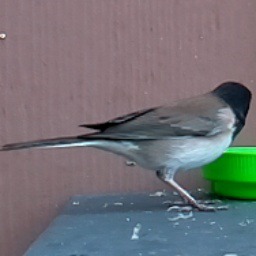

PURPLE GALLINULE 18%
MALAGASY WHITE EYE 13%
AMERICAN GOLDFINCH 12%


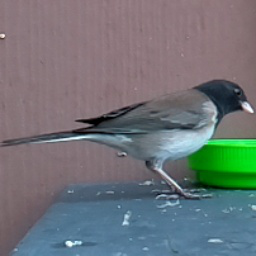

CANARY 29%
AMERICAN GOLDFINCH 26%
HOUSE SPARROW 21%


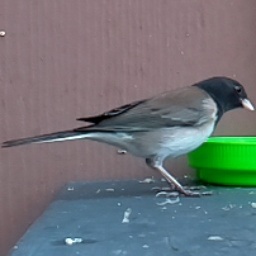

CANARY 78%
AMERICAN GOLDFINCH 16%
JAVA SPARROW 3%


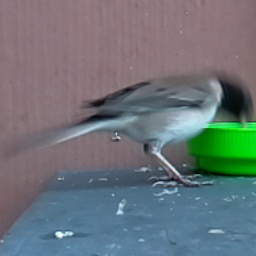

CANARY 82%
ROSY FACED LOVEBIRD 17%
JAVA SPARROW 0%


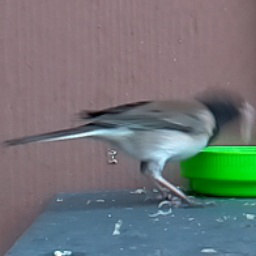

PURPLE GALLINULE 94%
CANARY 6%
MALAGASY WHITE EYE 0%


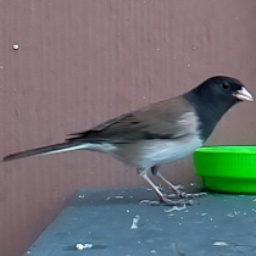

PURPLE GALLINULE 39%
CANARY 35%
EVENING GROSBEAK 15%


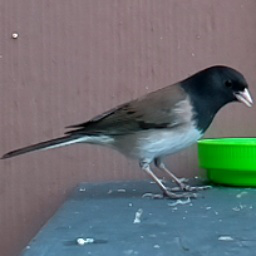

VIOLET GREEN SWALLOW 96%
MASKED LAPWING 2%
EVENING GROSBEAK 1%


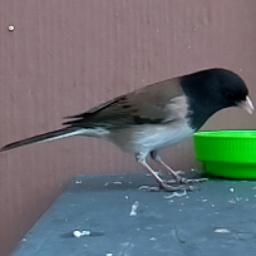

VIOLET GREEN SWALLOW 58%
GUINEA TURACO 18%
WHITE CHEEKED TURACO 17%


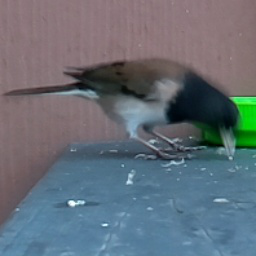

OYSTER CATCHER 98%
DARK EYED JUNCO 2%
PARAKETT  AKULET 1%


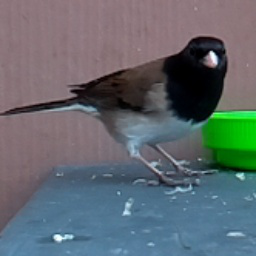

OYSTER CATCHER 99%
NORTHERN JACANA 0%
PARAKETT  AKULET 0%


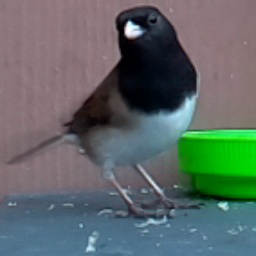

OYSTER CATCHER 97%
EASTERN TOWEE 1%
BLACK SKIMMER 1%


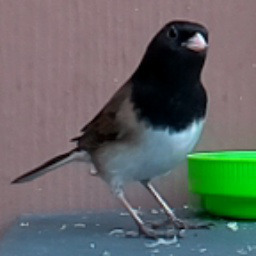

MASKED LAPWING 97%
NORTHERN JACANA 2%
CASPIAN TERN 1%


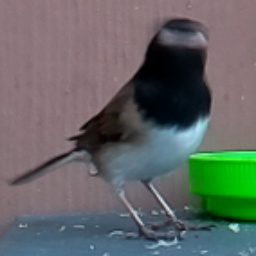

OYSTER CATCHER 68%
DARK EYED JUNCO 24%
NORTHERN JACANA 7%


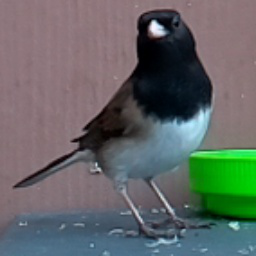

DARK EYED JUNCO 83%
EASTERN TOWEE 10%
BLACK-THROATED SPARROW 6%


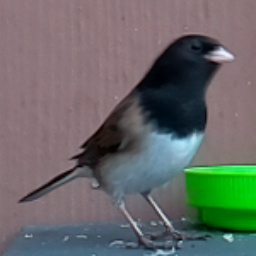

DARK EYED JUNCO 93%
EASTERN TOWEE 7%
LARK BUNTING 0%


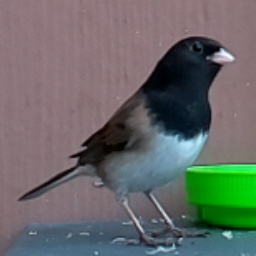

SUPERB STARLING 86%
PURPLE GALLINULE 6%
NORTHERN JACANA 3%


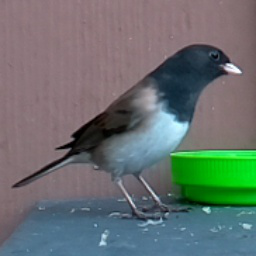

EASTERN TOWEE 45%
DARK EYED JUNCO 30%
BALTIMORE ORIOLE 12%


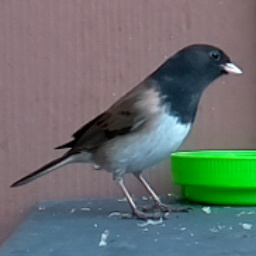

EASTERN TOWEE 46%
VIOLET GREEN SWALLOW 43%
SPOON BILED SANDPIPER 7%


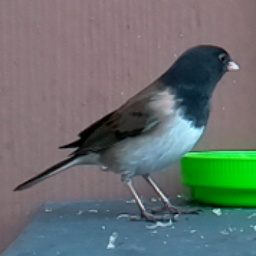

NORTHERN JACANA 53%
BALTIMORE ORIOLE 29%
PINK ROBIN 12%


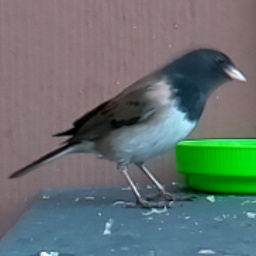

NORTHERN JACANA 87%
PURPLE GALLINULE 3%
MASKED LAPWING 3%


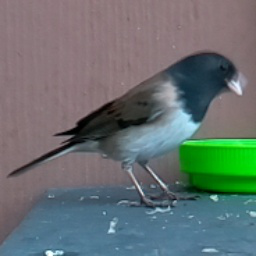

NORTHERN JACANA 78%
RED WISKERED BULBUL 6%
MASKED LAPWING 6%


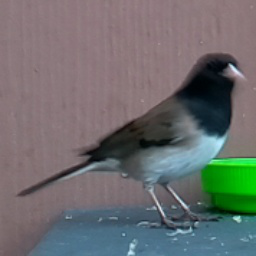

DARK EYED JUNCO 80%
EASTERN TOWEE 18%
RED WISKERED BULBUL 1%


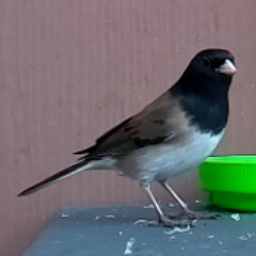

DARK EYED JUNCO 56%
EASTERN TOWEE 40%
BLACK-THROATED SPARROW 1%


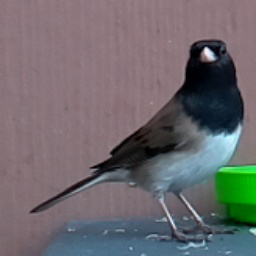

DARK EYED JUNCO 50%
EASTERN TOWEE 43%
LARK BUNTING 4%


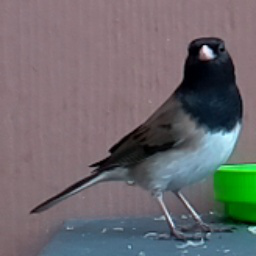

BALTIMORE ORIOLE 96%
EURASIAN MAGPIE 1%
EASTERN TOWEE 1%


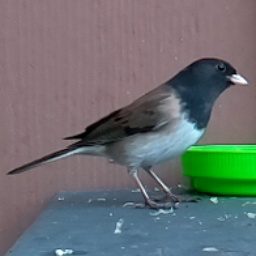

BALTIMORE ORIOLE 81%
EASTERN TOWEE 17%
DARK EYED JUNCO 0%


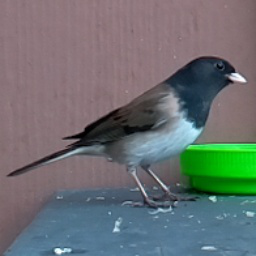

CANARY 25%
HOUSE SPARROW 22%
AMERICAN GOLDFINCH 17%


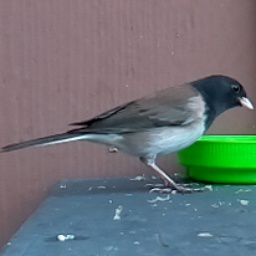

CANARY 88%
TIT MOUSE 5%
JAVA SPARROW 2%


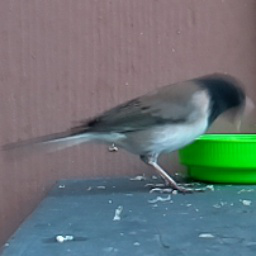

MANGROVE CUCKOO 43%
CANARY 17%
GUINEA TURACO 14%


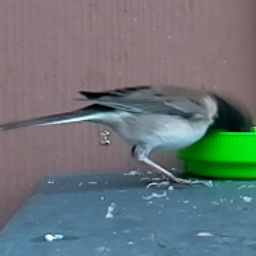

BALTIMORE ORIOLE 51%
PURPLE GALLINULE 37%
NORTHERN JACANA 3%


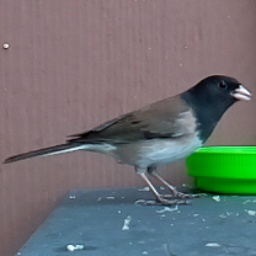

CANARY 55%
PURPLE GALLINULE 37%
BALTIMORE ORIOLE 3%


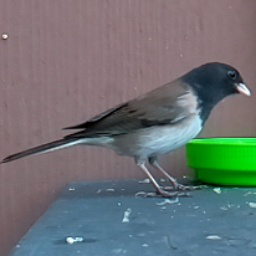

JAVA SPARROW 20%
ROSY FACED LOVEBIRD 17%
MALAGASY WHITE EYE 15%


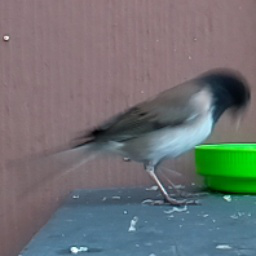

COMMON FIRECREST 32%
BLACK-THROATED SPARROW 26%
AMERICAN GOLDFINCH 22%


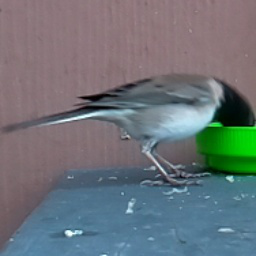

CANARY 100%
AMERICAN GOLDFINCH 0%
MANGROVE CUCKOO 0%


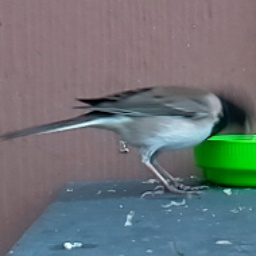

PURPLE GALLINULE 99%
DARK EYED JUNCO 0%
CANARY 0%


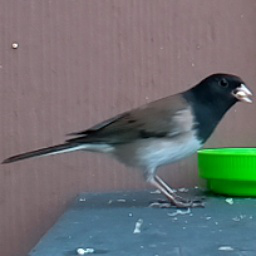

AMERICAN GOLDFINCH 63%
BALTIMORE ORIOLE 9%
TIT MOUSE 7%


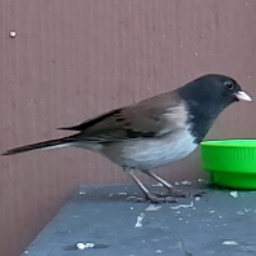

COMMON FIRECREST 54%
TIT MOUSE 15%
VIOLET GREEN SWALLOW 9%


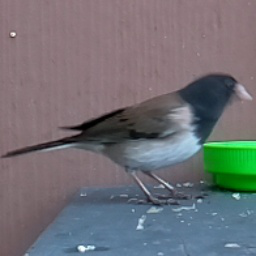

TIT MOUSE 36%
DARK EYED JUNCO 27%
PURPLE GALLINULE 25%


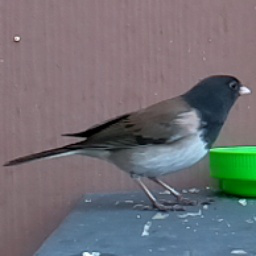

BALTIMORE ORIOLE 57%
AMERICAN GOLDFINCH 34%
BLACK THROATED WARBLER 2%


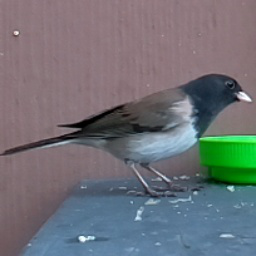

PURPLE GALLINULE 66%
AMERICAN GOLDFINCH 17%
EVENING GROSBEAK 11%


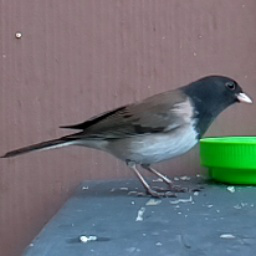

MANGROVE CUCKOO 62%
CANARY 26%
COUCHS KINGBIRD 5%


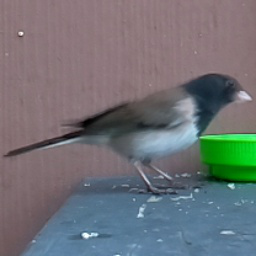

PURPLE GALLINULE 48%
CANARY 44%
NORTHERN JACANA 8%


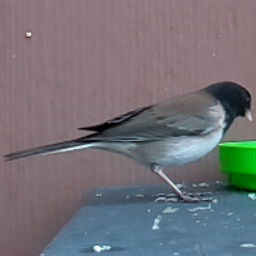

CANARY 77%
ROSY FACED LOVEBIRD 8%
JAVA SPARROW 4%


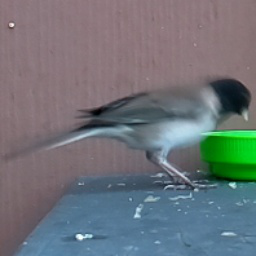

TIT MOUSE 65%
CANARY 13%
JAVA SPARROW 10%


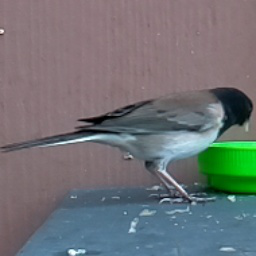

ROSY FACED LOVEBIRD 35%
BALI STARLING 14%
MANGROVE CUCKOO 13%


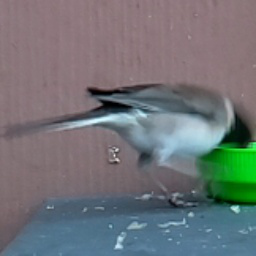

PURPLE GALLINULE 96%
CANARY 2%
ROCK DOVE 1%


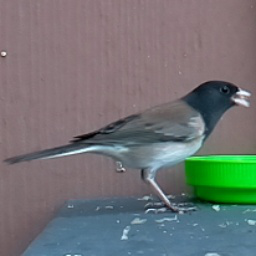

EASTERN TOWEE 58%
NORTHERN JACANA 28%
DARK EYED JUNCO 13%


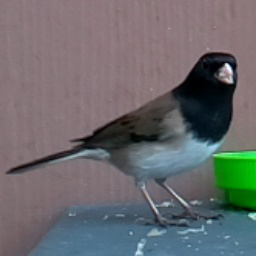

DARK EYED JUNCO 98%
BLACK-THROATED SPARROW 1%
EURASIAN MAGPIE 0%


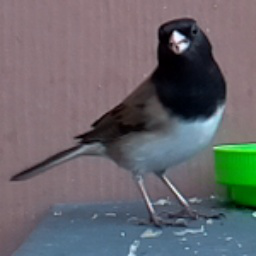

DARK EYED JUNCO 99%
EASTERN TOWEE 1%
SUPERB STARLING 0%


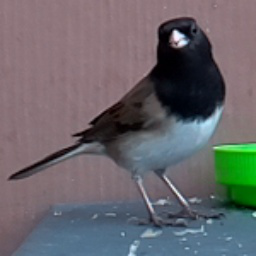

MASKED LAPWING 73%
BLACK THROATED WARBLER 16%
EASTERN TOWEE 9%


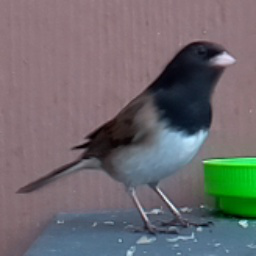

EASTERN TOWEE 51%
DARK EYED JUNCO 49%
BLACK-THROATED SPARROW 0%


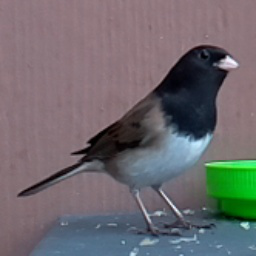

EASTERN TOWEE 62%
DARK EYED JUNCO 27%
EURASIAN MAGPIE 7%


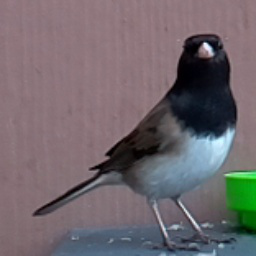

CASPIAN TERN 30%
EURASIAN MAGPIE 28%
EASTERN TOWEE 20%


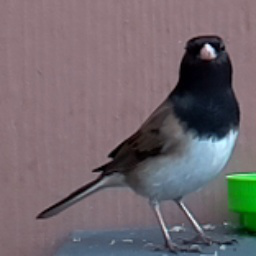

MASKED LAPWING 98%
CASPIAN TERN 1%
NORTHERN JACANA 0%


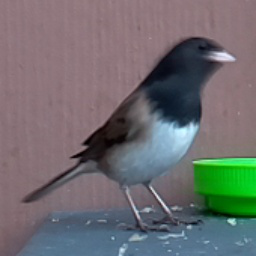

EASTERN TOWEE 58%
DARK EYED JUNCO 36%
EURASIAN MAGPIE 5%


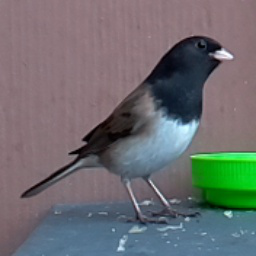

BALTIMORE ORIOLE 97%
CANARY 1%
AMERICAN GOLDFINCH 1%


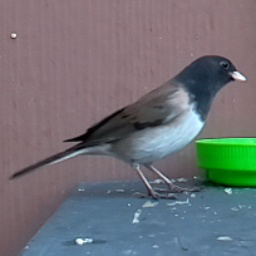

BALTIMORE ORIOLE 96%
AMERICAN GOLDFINCH 2%
CANARY 0%


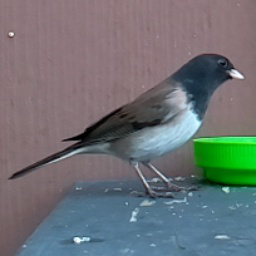

COUCHS KINGBIRD 35%
MALAGASY WHITE EYE 27%
CANARY 26%


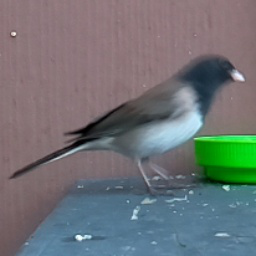

NORTHERN JACANA 28%
BLACK-THROATED SPARROW 21%
TIT MOUSE 19%


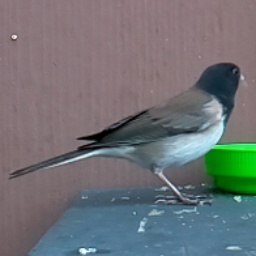

PURPLE GALLINULE 98%
CANARY 1%
MALAGASY WHITE EYE 0%


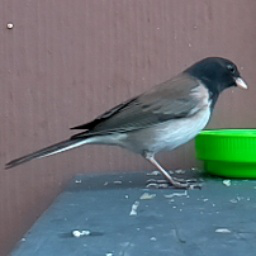

JAVA SPARROW 26%
ROSY FACED LOVEBIRD 19%
CANARY 14%


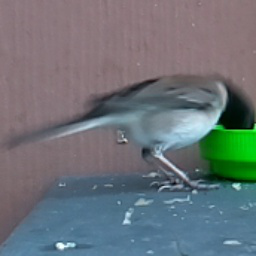

PURPLE GALLINULE 91%
CANARY 9%
BALTIMORE ORIOLE 0%


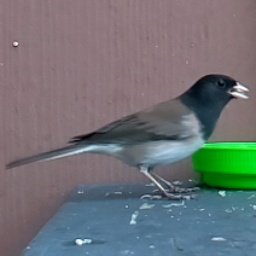

NORTHERN JACANA 97%
DARK EYED JUNCO 2%
BLACK-THROATED SPARROW 1%


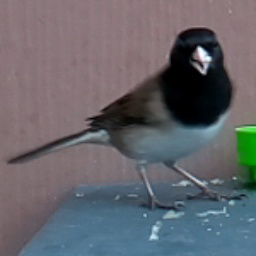

DARK EYED JUNCO 88%
BLACK-THROATED SPARROW 11%
MASKED LAPWING 0%


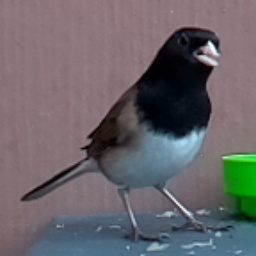

DARK EYED JUNCO 100%
EASTERN TOWEE 0%
LARK BUNTING 0%


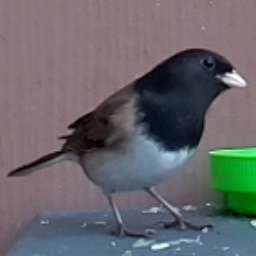

TIT MOUSE 61%
PURPLE GALLINULE 9%
MALAGASY WHITE EYE 7%


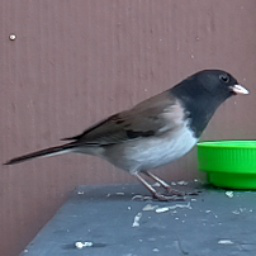

TIT MOUSE 66%
MALAGASY WHITE EYE 20%
CANARY 8%


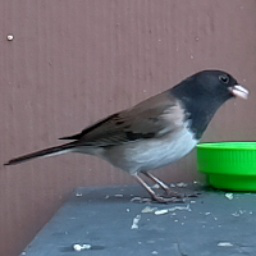

CANARY 32%
BALTIMORE ORIOLE 27%
PURPLE GALLINULE 13%


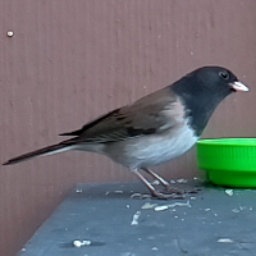

CANARY 33%
BALTIMORE ORIOLE 27%
PURPLE GALLINULE 9%


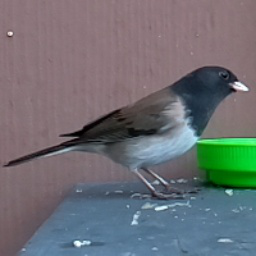

WHITE BROWED CRAKE 36%
BALTIMORE ORIOLE 26%
PURPLE GALLINULE 25%


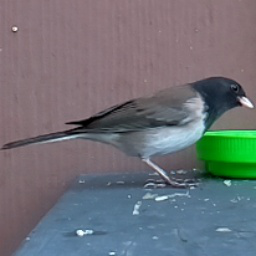

WHITE BROWED CRAKE 54%
PURPLE GALLINULE 31%
EVENING GROSBEAK 5%


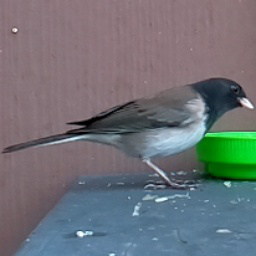

MANGROVE CUCKOO 33%
WHITE BROWED CRAKE 31%
PURPLE GALLINULE 10%


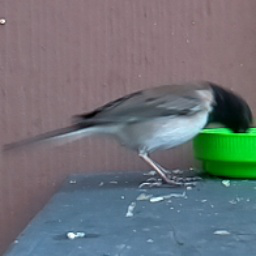

CANARY 83%
MALLARD DUCK 9%
GUINEA TURACO 3%


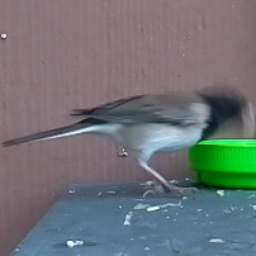

DARK EYED JUNCO 99%
TIT MOUSE 0%
BLACK-THROATED SPARROW 0%


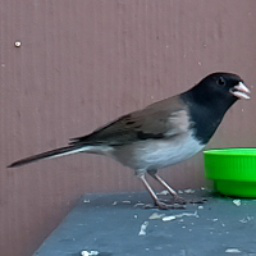

DARK EYED JUNCO 99%
BLACK-THROATED SPARROW 1%
PARUS MAJOR 0%


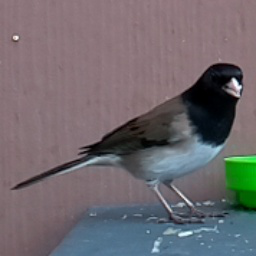

BLACK-THROATED SPARROW 21%
TIT MOUSE 19%
RED WISKERED BULBUL 13%


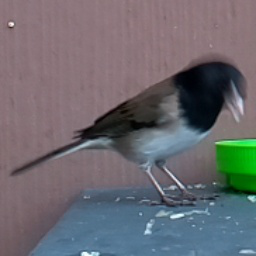

DARK EYED JUNCO 93%
EASTERN TOWEE 4%
NORTHERN JACANA 2%


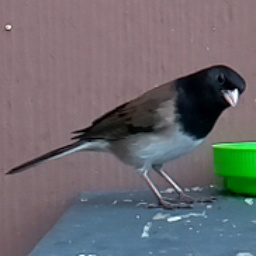

MASKED LAPWING 27%
VIOLET GREEN SWALLOW 26%
NORTHERN JACANA 25%


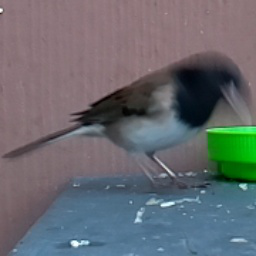

NORTHERN JACANA 49%
AMERICAN REDSTART 34%
BLACK THROATED WARBLER 11%


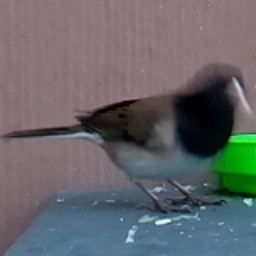

NORTHERN JACANA 98%
PURPLE GALLINULE 1%
AMERICAN REDSTART 1%


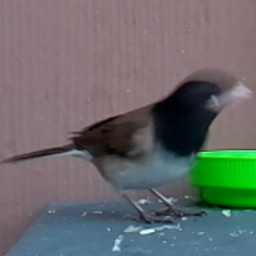

NORTHERN JACANA 100%
MASKED LAPWING 0%
MALLARD DUCK 0%


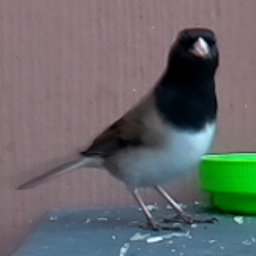

SPOON BILED SANDPIPER 81%
MASKED LAPWING 12%
NORTHERN JACANA 3%


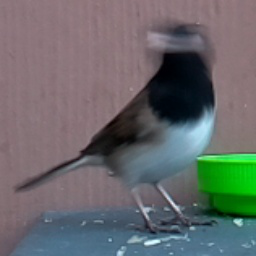

DARK EYED JUNCO 47%
MASKED LAPWING 22%
NORTHERN JACANA 19%


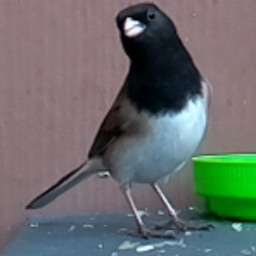

JAVA SPARROW 50%
MASKED LAPWING 35%
NORTHERN JACANA 15%


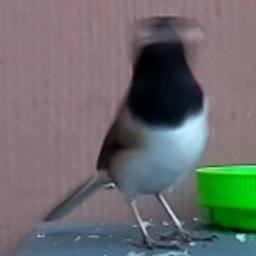

NORTHERN JACANA 68%
DARK EYED JUNCO 14%
MASKED LAPWING 7%


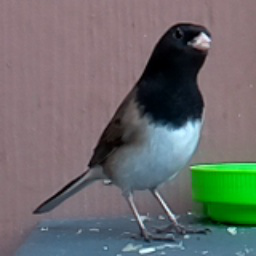

DARK EYED JUNCO 96%
EASTERN TOWEE 3%
NORTHERN JACANA 1%


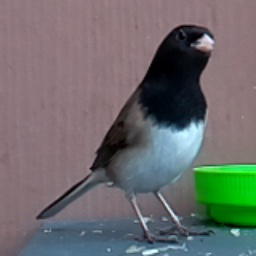

DARK EYED JUNCO 97%
EURASIAN MAGPIE 2%
NORTHERN JACANA 1%


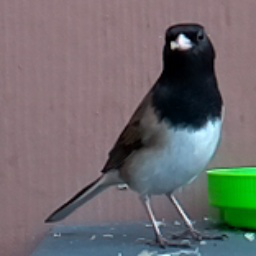

EASTERN TOWEE 98%
DARK EYED JUNCO 1%
NORTHERN JACANA 1%


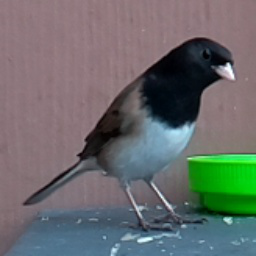

NORTHERN JACANA 88%
INDIAN PITTA 5%
NORTHERN RED BISHOP 3%


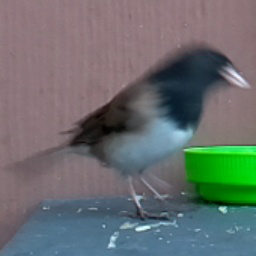

BALTIMORE ORIOLE 93%
PURPLE GALLINULE 5%
AMERICAN GOLDFINCH 2%


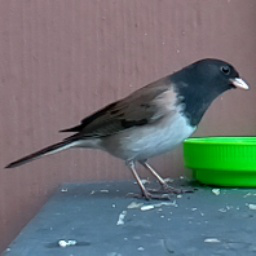

MYNA 30%
BALTIMORE ORIOLE 28%
PARUS MAJOR 12%


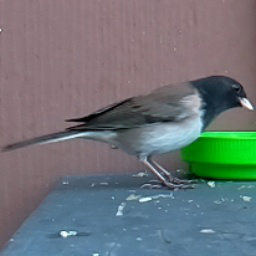

BLACK-THROATED SPARROW 68%
HOUSE SPARROW 7%
CANARY 7%


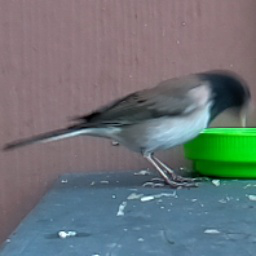

CANARY 66%
BALI STARLING 18%
MANGROVE CUCKOO 9%


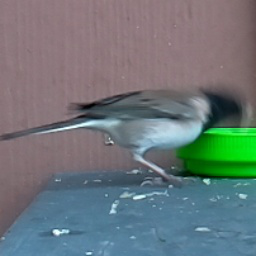

BALTIMORE ORIOLE 67%
PURPLE GALLINULE 26%
DARK EYED JUNCO 4%


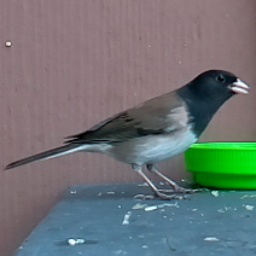

AMERICAN GOLDFINCH 60%
PURPLE GALLINULE 29%
CANARY 5%


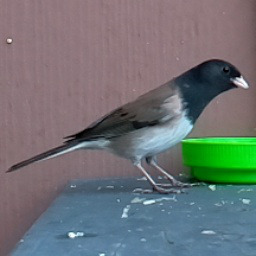

CANARY 51%
BALTIMORE ORIOLE 18%
HOUSE SPARROW 13%


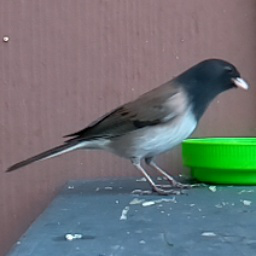

BALTIMORE ORIOLE 46%
PURPLE GALLINULE 30%
AMERICAN GOLDFINCH 17%


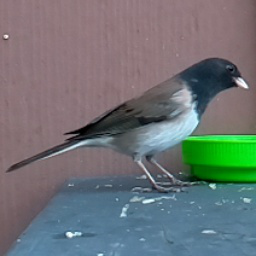

CANARY 65%
TIT MOUSE 21%
AMERICAN GOLDFINCH 5%


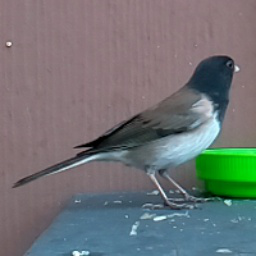

NORTHERN JACANA 52%
CANARY 21%
BLACK-THROATED SPARROW 7%


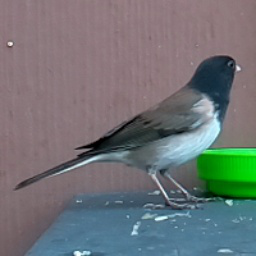

NORTHERN JACANA 95%
CANARY 1%
BLACK-THROATED SPARROW 1%


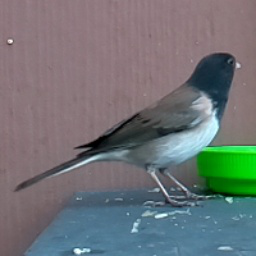

BLACK-THROATED SPARROW 74%
DARK EYED JUNCO 15%
COUCHS KINGBIRD 3%


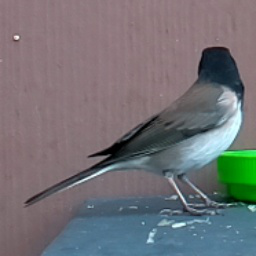

CASPIAN TERN 35%
CANARY 24%
COUCHS KINGBIRD 20%


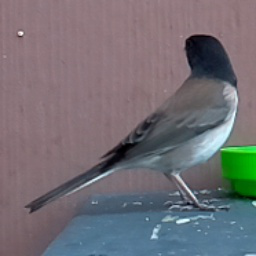

BLACK-THROATED SPARROW 37%
CANARY 36%
DARK EYED JUNCO 8%


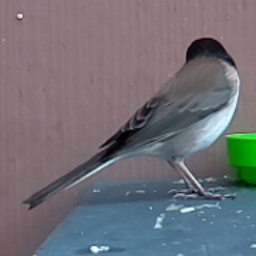

COUCHS KINGBIRD 46%
BLACK-THROATED SPARROW 18%
CANARY 11%


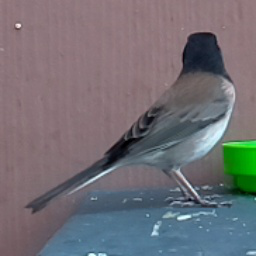

BLACK-THROATED SPARROW 40%
COUCHS KINGBIRD 27%
CANARY 12%


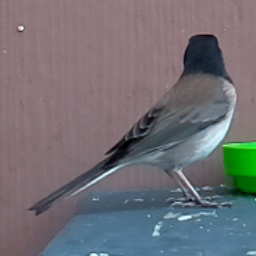

EVENING GROSBEAK 68%
CANARY 25%
PURPLE GALLINULE 4%


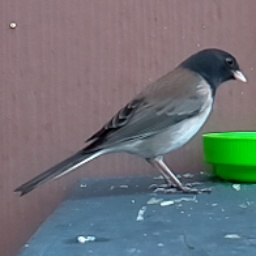

CANARY 61%
ROSY FACED LOVEBIRD 14%
JAVA SPARROW 11%


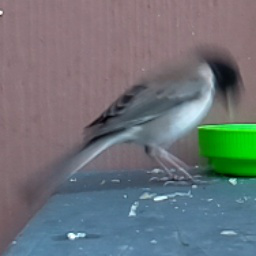

CANARY 94%
AMERICAN GOLDFINCH 2%
BALI STARLING 1%


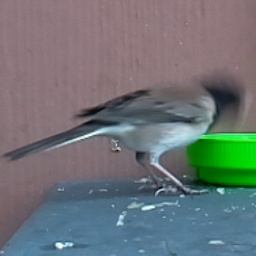

PURPLE GALLINULE 52%
CANARY 19%
EVENING GROSBEAK 11%


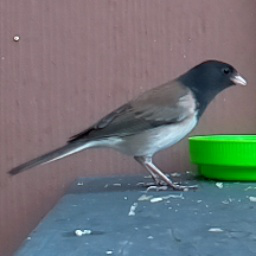

DARK EYED JUNCO 97%
TIT MOUSE 3%
JAVA SPARROW 0%


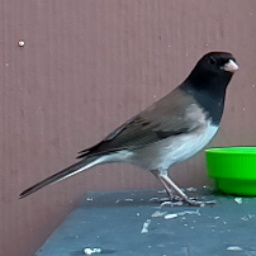

DARK EYED JUNCO 87%
TIT MOUSE 13%
BLACK-THROATED SPARROW 0%


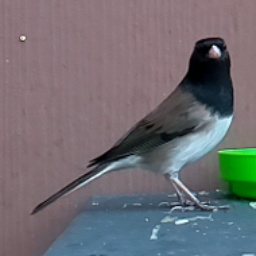

DARK EYED JUNCO 90%
TIT MOUSE 10%
BLACK-THROATED SPARROW 0%


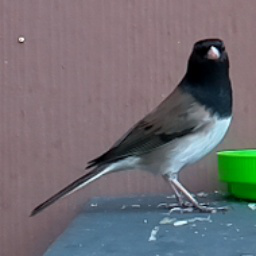

BALTIMORE ORIOLE 45%
AMERICAN GOLDFINCH 33%
CANARY 20%


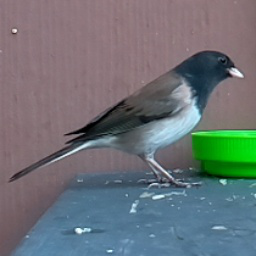

BALI STARLING 44%
MALLARD DUCK 10%
CANARY 10%


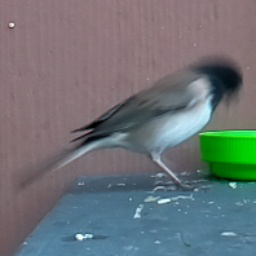

COMMON FIRECREST 38%
CANARY 15%
TOWNSENDS WARBLER 11%


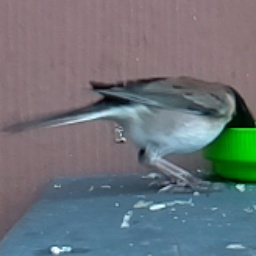

PURPLE GALLINULE 97%
JAVA SPARROW 2%
MALAGASY WHITE EYE 0%


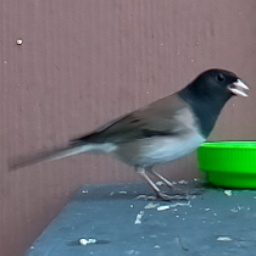

JAVA SPARROW 100%
NORTHERN JACANA 0%
DOUBLE BARRED FINCH 0%


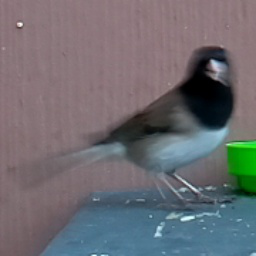

NORTHERN JACANA 87%
MASKED LAPWING 9%
BLACK THROATED WARBLER 1%


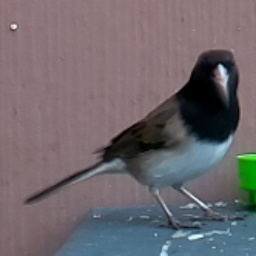

NORTHERN JACANA 85%
MASKED LAPWING 10%
BLACK-THROATED SPARROW 2%


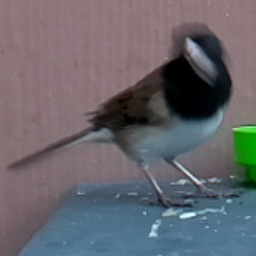

EURASIAN MAGPIE 85%
LARK BUNTING 9%
EASTERN TOWEE 4%


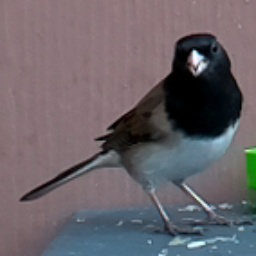

EASTERN TOWEE 52%
DARK EYED JUNCO 31%
LARK BUNTING 11%


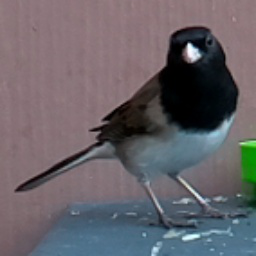

EASTERN TOWEE 73%
EURASIAN MAGPIE 26%
LARK BUNTING 0%


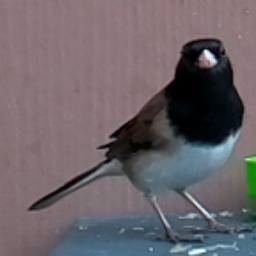

EURASIAN MAGPIE 79%
EASTERN TOWEE 19%
LARK BUNTING 1%


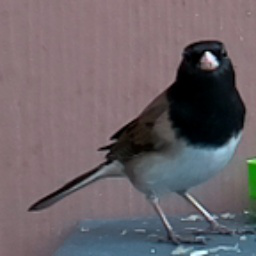

EASTERN TOWEE 48%
DARK EYED JUNCO 46%
EURASIAN MAGPIE 3%


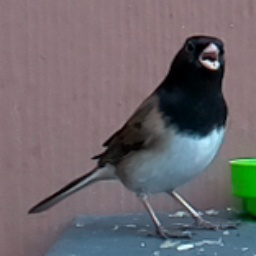

EASTERN TOWEE 46%
DARK EYED JUNCO 33%
EURASIAN MAGPIE 19%


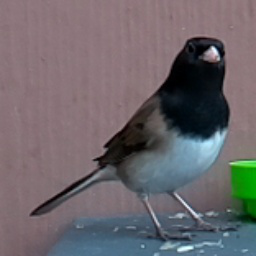

EASTERN TOWEE 64%
EURASIAN MAGPIE 18%
DARK EYED JUNCO 14%


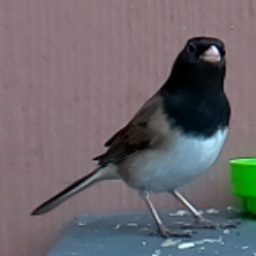

DARK EYED JUNCO 79%
EASTERN TOWEE 17%
BLACK THROATED WARBLER 3%


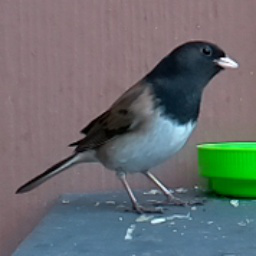

DARK EYED JUNCO 90%
EASTERN TOWEE 5%
EURASIAN MAGPIE 4%


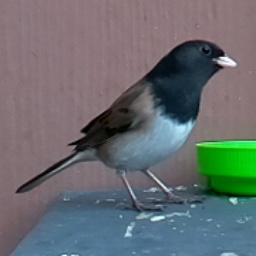

BALTIMORE ORIOLE 95%
AMERICAN GOLDFINCH 4%
PINK ROBIN 0%


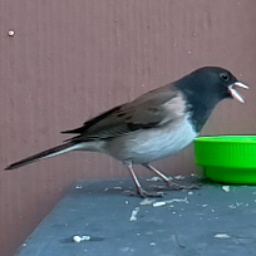

BALTIMORE ORIOLE 91%
AMERICAN GOLDFINCH 5%
PURPLE GALLINULE 4%


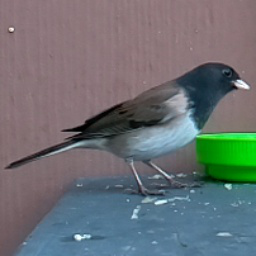

MANGROVE CUCKOO 49%
COUCHS KINGBIRD 15%
MALAGASY WHITE EYE 8%


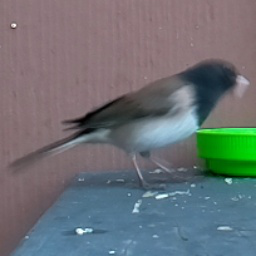

PURPLE GALLINULE 92%
WHITE BROWED CRAKE 5%
NORTHERN JACANA 2%


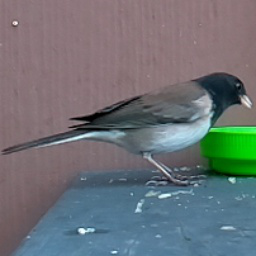

NORTHERN JACANA 64%
PURPLE GALLINULE 22%
DARK EYED JUNCO 6%


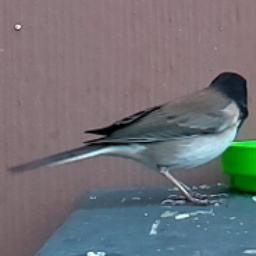

DARK EYED JUNCO 35%
NORTHERN JACANA 27%
BLACK-THROATED SPARROW 18%


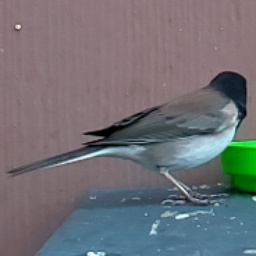

PURPLE GALLINULE 100%
CANARY 0%
EVENING GROSBEAK 0%


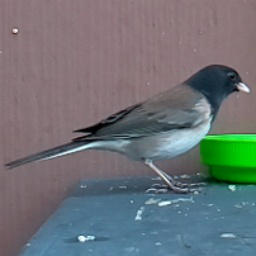

PURPLE GALLINULE 42%
WHITE BROWED CRAKE 36%
MALLARD DUCK 13%


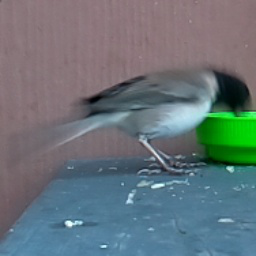

MALLARD DUCK 70%
NORTHERN JACANA 10%
PURPLE GALLINULE 7%


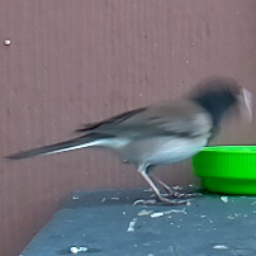

ROSY FACED LOVEBIRD 74%
ALEXANDRINE PARAKEET 15%
PURPLE GALLINULE 7%


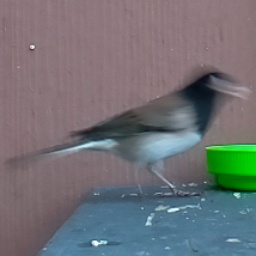

DARK EYED JUNCO 39%
EASTERN TOWEE 25%
BLACK-THROATED SPARROW 16%


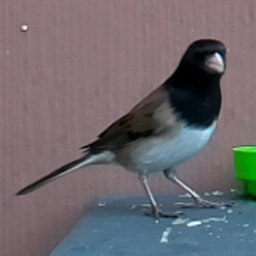

DARK EYED JUNCO 74%
EURASIAN MAGPIE 14%
OYSTER CATCHER 12%


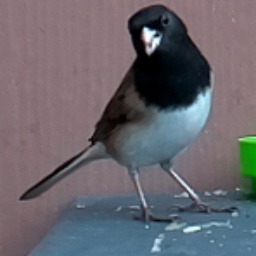

MASKED LAPWING 96%
MYNA 1%
EURASIAN MAGPIE 1%


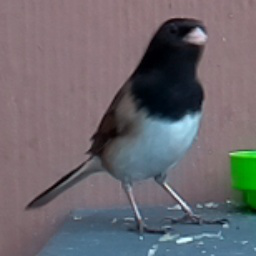

MASKED LAPWING 80%
EURASIAN MAGPIE 14%
JAVA SPARROW 3%


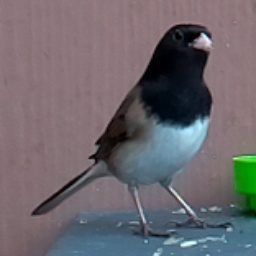

MASKED LAPWING 76%
NORTHERN JACANA 24%
BLACK-THROATED SPARROW 0%


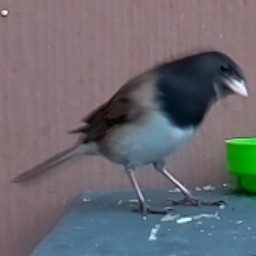

NORTHERN JACANA 49%
DARK EYED JUNCO 47%
MASKED LAPWING 3%


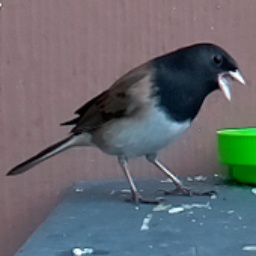

NORTHERN JACANA 72%
MASKED LAPWING 26%
SPOON BILED SANDPIPER 2%


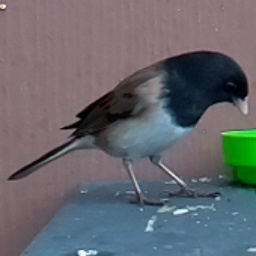

BALTIMORE ORIOLE 64%
PINK ROBIN 31%
DARK EYED JUNCO 1%


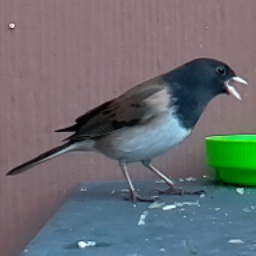

BALTIMORE ORIOLE 88%
PINK ROBIN 3%
AMERICAN GOLDFINCH 2%


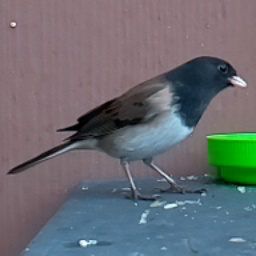

NORTHERN JACANA 74%
BEARDED REEDLING 9%
COUCHS KINGBIRD 8%


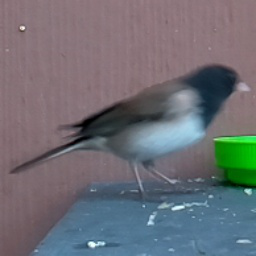

TIT MOUSE 51%
DARK EYED JUNCO 14%
BLACK-THROATED SPARROW 9%


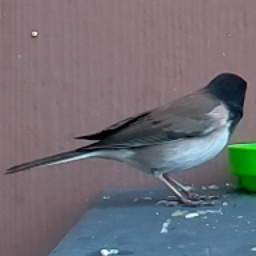

MANGROVE CUCKOO 57%
WHITE BROWED CRAKE 13%
ALEXANDRINE PARAKEET 8%


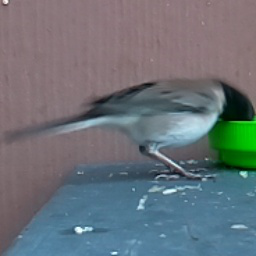

MANGROVE CUCKOO 65%
PURPLE GALLINULE 21%
GUINEA TURACO 6%


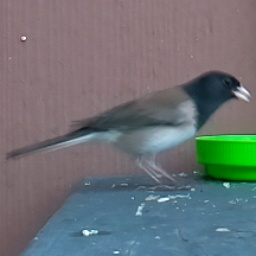

BLACK-THROATED SPARROW 86%
DARK EYED JUNCO 8%
RED FACED WARBLER 2%


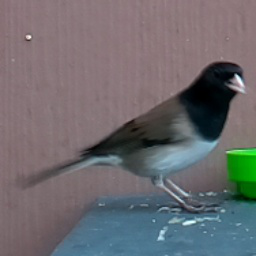

DARK EYED JUNCO 100%
BLACK-THROATED SPARROW 0%
EASTERN TOWEE 0%


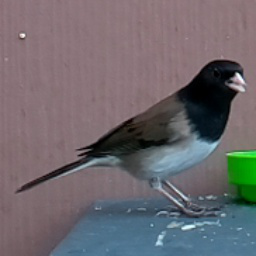

DARK EYED JUNCO 80%
BLACK-THROATED SPARROW 15%
JAVA SPARROW 2%


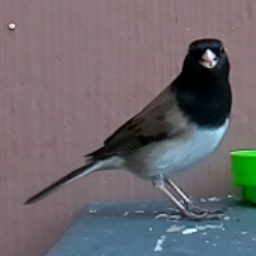

DARK EYED JUNCO 47%
BLACK-THROATED SPARROW 36%
TIT MOUSE 9%


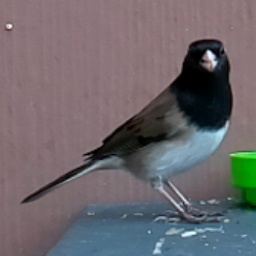

DARK EYED JUNCO 95%
BLACK-THROATED SPARROW 5%
TIT MOUSE 0%


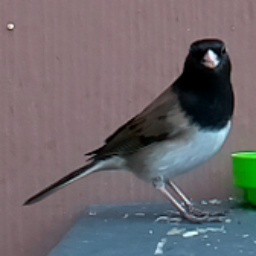

DARK EYED JUNCO 95%
EASTERN TOWEE 4%
EURASIAN MAGPIE 0%


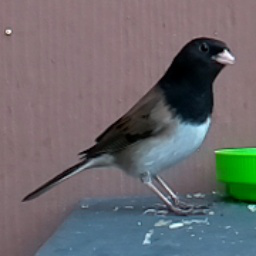

RED WISKERED BULBUL 33%
MASKED LAPWING 31%
GREAT KISKADEE 17%


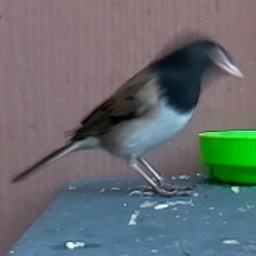

AMERICAN GOLDFINCH 38%
BALTIMORE ORIOLE 27%
EURASIAN MAGPIE 16%


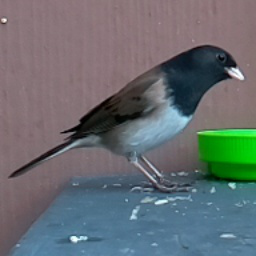

AMERICAN GOLDFINCH 45%
BALTIMORE ORIOLE 39%
EVENING GROSBEAK 9%


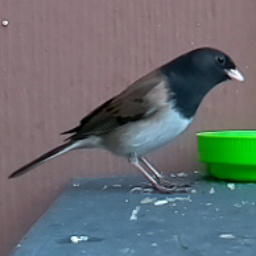

BALTIMORE ORIOLE 92%
AMERICAN GOLDFINCH 7%
EVENING GROSBEAK 0%


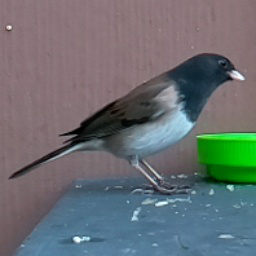

BALTIMORE ORIOLE 71%
AMERICAN GOLDFINCH 28%
EVENING GROSBEAK 0%


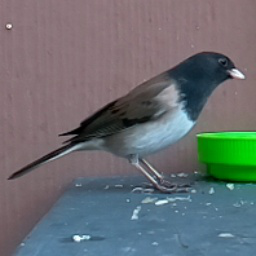

GRAY KINGBIRD 69%
VIOLET GREEN SWALLOW 12%
COUCHS KINGBIRD 6%


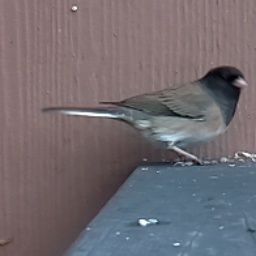

DARK EYED JUNCO 98%
EURASIAN MAGPIE 1%
COMMON GRACKLE 0%


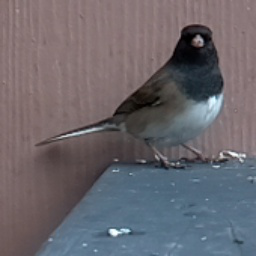

DARK EYED JUNCO 95%
BLACK-THROATED SPARROW 3%
TREE SWALLOW 2%


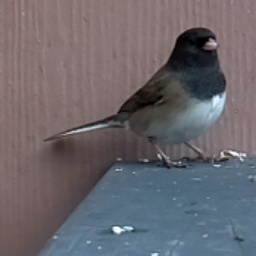

DARK EYED JUNCO 57%
TREE SWALLOW 29%
GO AWAY BIRD 8%


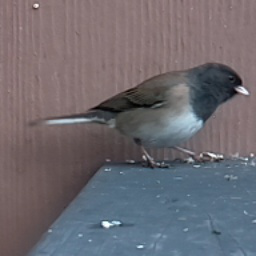

BLUE HERON 41%
TRUMPTER SWAN 23%
TREE SWALLOW 9%


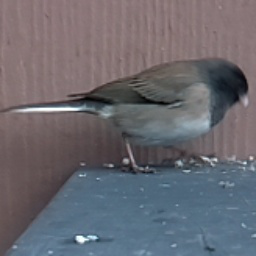

GRAY KINGBIRD 23%
CRESTED NUTHATCH 21%
TROPICAL KINGBIRD 17%


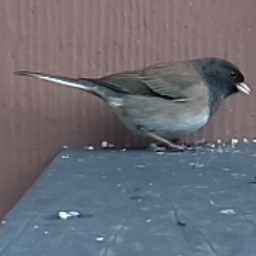

MANGROVE CUCKOO 61%
GRAY KINGBIRD 21%
BARN SWALLOW 8%


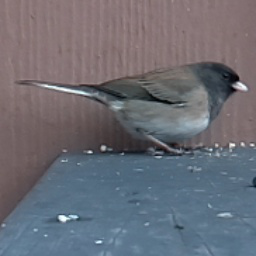

DARK EYED JUNCO 92%
BLACK-THROATED SPARROW 4%
TREE SWALLOW 2%


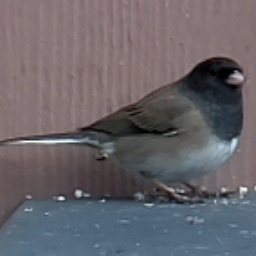

TRUMPTER SWAN 35%
CALIFORNIA GULL 21%
HORNED LARK 5%


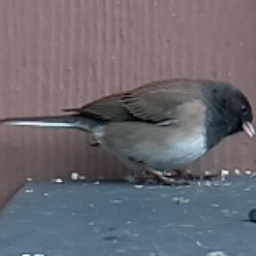

TRUMPTER SWAN 79%
BLUE HERON 15%
CALIFORNIA GULL 2%


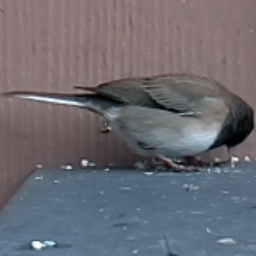

DARK EYED JUNCO 52%
BLACK-THROATED SPARROW 42%
TREE SWALLOW 2%


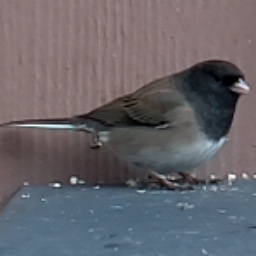

BLACK-THROATED SPARROW 64%
COMMON HOUSE MARTIN 22%
SAND MARTIN 7%


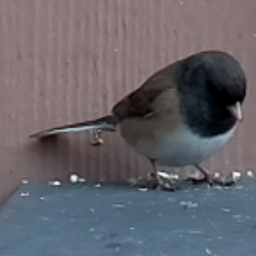

DARK EYED JUNCO 100%
COMMON HOUSE MARTIN 0%
EURASIAN MAGPIE 0%


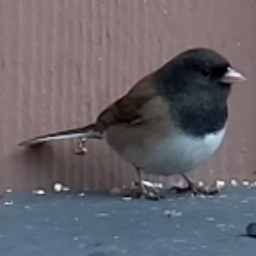

DARK EYED JUNCO 60%
COMMON HOUSE MARTIN 33%
TREE SWALLOW 2%


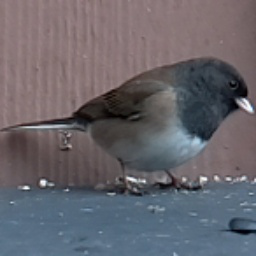

COMMON HOUSE MARTIN 23%
SAND MARTIN 23%
TREE SWALLOW 16%


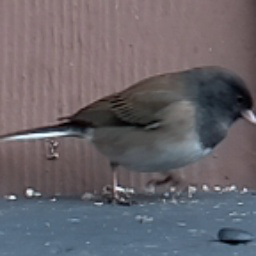

TRUMPTER SWAN 98%
BLUE HERON 2%
AMERICAN AVOCET 0%


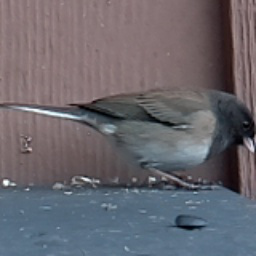

TRUMPTER SWAN 87%
NORTHERN GANNET 6%
BLUE HERON 5%


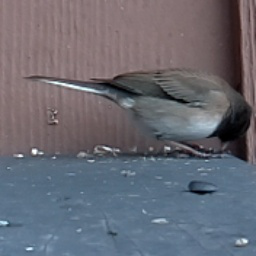

GRAY KINGBIRD 96%
DARK EYED JUNCO 1%
BEARDED REEDLING 1%


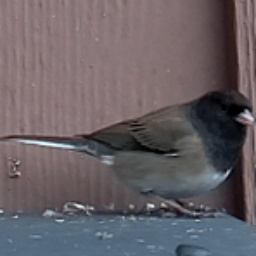

CALIFORNIA GULL 44%
ALBATROSS 8%
HORNED LARK 7%


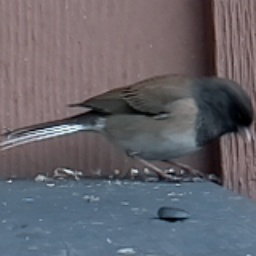

CRESTED NUTHATCH 56%
BLUE HERON 14%
TRUMPTER SWAN 13%


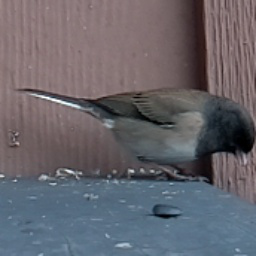

CRESTED NUTHATCH 98%
GRAY KINGBIRD 2%
COMMON HOUSE MARTIN 0%


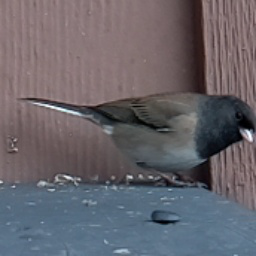

CRESTED NUTHATCH 68%
DARK EYED JUNCO 16%
SAND MARTIN 9%


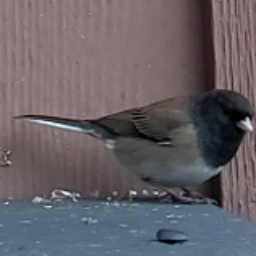

CRESTED NUTHATCH 98%
COMMON HOUSE MARTIN 1%
SAND MARTIN 0%


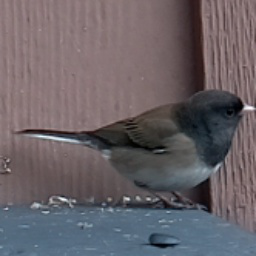

DARK EYED JUNCO 45%
BLACK-THROATED SPARROW 27%
TREE SWALLOW 16%


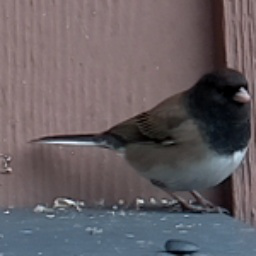

DARK EYED JUNCO 91%
EURASIAN MAGPIE 7%
BLACK THROATED WARBLER 1%


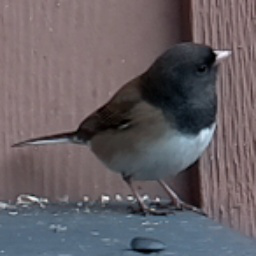

DARK EYED JUNCO 100%
EURASIAN MAGPIE 0%
BLACK-THROATED SPARROW 0%


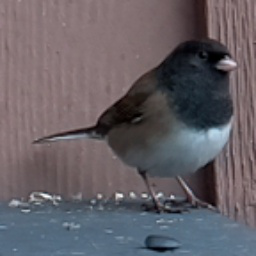

DARK EYED JUNCO 100%
EURASIAN MAGPIE 0%
BLACK THROATED WARBLER 0%


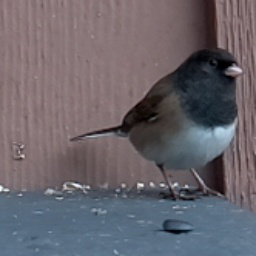

CASPIAN TERN 85%
JAVA SPARROW 4%
ANHINGA 3%


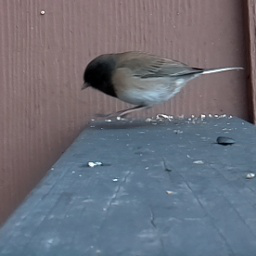

SAND MARTIN 85%
CRESTED NUTHATCH 8%
BARN SWALLOW 5%


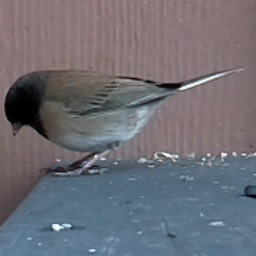

DARK EYED JUNCO 100%
BLACK THROATED WARBLER 0%
EASTERN TOWEE 0%


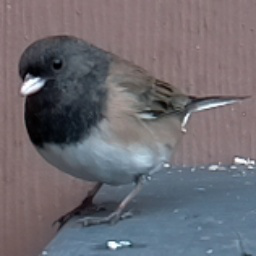

DARK EYED JUNCO 100%
BLACK THROATED WARBLER 0%
BAY-BREASTED WARBLER 0%


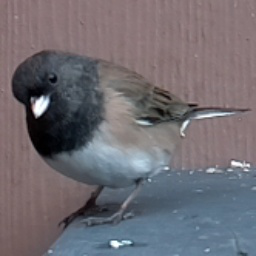

DARK EYED JUNCO 99%
EASTERN TOWEE 0%
BLACK THROATED WARBLER 0%


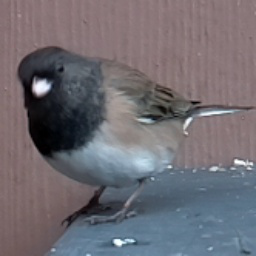

DARK EYED JUNCO 100%
LARK BUNTING 0%
EASTERN TOWEE 0%


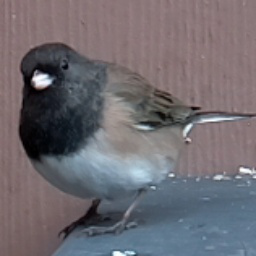

DARK EYED JUNCO 100%
LARK BUNTING 0%
EASTERN TOWEE 0%


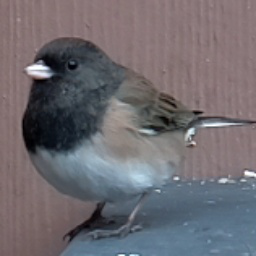

DARK EYED JUNCO 82%
POMARINE JAEGER 14%
PARAKETT  AKULET 2%


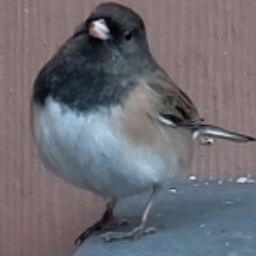

EMPEROR PENGUIN 86%
PUFFIN 8%
RAZORBILL 4%


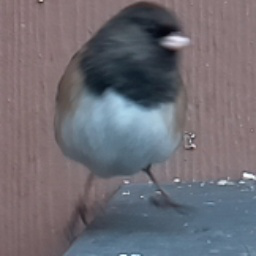

DARK EYED JUNCO 100%
LARK BUNTING 0%
BLACK-THROATED SPARROW 0%


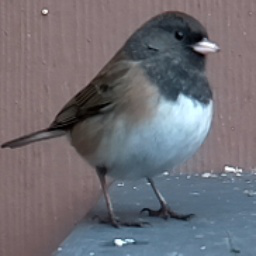

In [ ]:
try:
    prediction_files = listdir(local_test_dir+'/DARK EYED JUNCO')
    prediction_files.remove('.ipynb_checkpoints')
except ValueError:
    pass

for image in prediction_files:
    image = load_img(path.join(local_test_dir+'/DARK EYED JUNCO', image), target_size=(256, 256))
    predict_on_image(image)

In [46]:
local_test_dir = path.join(base_dir, "local_bird_test")
local_test_ds = image_dataset_from_directory(local_test_dir, label_mode="categorical", batch_size=batch_size, image_size=image_size)

Found 307 files belonging to 325 classes.


In [47]:
model.evaluate(local_test_ds)

13/13 [==============================] - 45s 4s/step - loss: 8.1432 - acc: 0.2020


[8.143213272094727, 0.20195439457893372]